# MLP for the Proposal Video

## Improvement Ideas
 - Penalize false positives more heavily using the Loss
 - Create bigger Dataset
 - Include the algorithms introduced in the Paper
 - Possibly change to CNN

## Current Problems
 - To many ill as healthy classified, especcialy early blight
 - To confident in wrong predictions



## 1. Import the required libraries

In [1]:
!pip install torchsummary
!pip install kagglehub

import os
import time
import zipfile
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.patches import Rectangle
from matplotlib import transforms as mtransforms

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import models, datasets, transforms
from torchsummary import summary
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

import kagglehub

## 2. Set model parameters

In [2]:
num_classes = 3

# Define the batch size (16 or 32 reccomended)
batch_size = 16

# Define the size the images get resized to (64 reccomended)
image_size = 224

# Number of epochs the trainig runs (150 reccomended)
number_of_epochs = 1000

# Number of epochs without improvement of loss till the training get terminated early (20 reccomended)
early_stop_patience = 20

# If the dataset should be taken from the zip file (false reccomended (then the dataset gets downloaded))
dataset_as_zip = False

# Path of the zip file (only needed if dataset_as_zip = True)
zip_path = "../data/potato_blight.zip"

# Path where the best model should be saved to
best_model_path = '../content/best_model/best_model.pth'
if not os.path.exists(os.path.dirname(best_model_path)):
    os.makedirs(os.path.dirname(best_model_path))


## 3. Get the dataset

### 3.1 Import the dataset

In [3]:
if not dataset_as_zip:

    path = kagglehub.dataset_download("muhammadardiputra/potato-leaf-disease-dataset")

else:

    if not os.path.exists(zip_path):
        raise FileNotFoundError(f"The data expected at '{zip_path}' was not found.")

    path = "../.extracted_data"

    if not os.path.exists(path):
        os.makedirs(path)

    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(path)

train_data_path = os.path.join(path + "/Potato", "Train")
test_data_path = os.path.join(path + "/Potato", "Test")
valid_data_path = os.path.join(path + "/Potato", "Valid")

### 3.2 Transform and argument the dataset

In [4]:
train_transform = transforms.Compose([
    transforms.RandomApply([transforms.Grayscale(num_output_channels=3)], p=0.5),
    transforms.Resize((image_size, image_size)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_transform = transforms.Compose([
    transforms.Resize((image_size, image_size)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = datasets.ImageFolder(root=train_data_path, transform=train_transform)
val_dataset = datasets.ImageFolder(root=valid_data_path, transform=val_transform)
test_dataset = datasets.ImageFolder(root=test_data_path, transform=val_transform)

### 3.3 Load the data into batches

In [5]:
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

## 4. Define AlexNet for feature extraction
(we will only use the feature extraction part of the model)

In [6]:
alexnet = models.alexnet(pretrained=True)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Device:', device)
alexnet.to(device)

num_params = sum(p.numel() for p in alexnet.parameters() if p.requires_grad)
print("Number of trainable parameters:", num_params)

summary(alexnet, (3, image_size, image_size))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Device: cpu
Number of trainable parameters: 61100840
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 55, 55]          23,296
              ReLU-2           [-1, 64, 55, 55]               0
         MaxPool2d-3           [-1, 64, 27, 27]               0
            Conv2d-4          [-1, 192, 27, 27]         307,392
              ReLU-5          [-1, 192, 27, 27]               0
         MaxPool2d-6          [-1, 192, 13, 13]               0
            Conv2d-7          [-1, 384, 13, 13]         663,936
              ReLU-8          [-1, 384, 13, 13]               0
            Conv2d-9          [-1, 256, 13, 13]         884,992
             ReLU-10          [-1, 256, 13, 13]               0
           Conv2d-11          [-1, 256, 13, 13]         590,080
             ReLU-12          [-1, 256, 13, 13]               0
        MaxPool2d-13            [-1, 256, 6, 6]   

In [7]:
def extract_features(model, dataloader, device):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for data, target in dataloader:
            data, target = data.to(device), target.to(device)
            output = model.features(data)
            features.append(output.view(output.size(0), -1).cpu().numpy())
            labels.append(target.cpu().numpy())
    return np.vstack(features), np.hstack(labels)

##5. WWPASC implementation

In [8]:
def fitness_function(features, labels, selected_features):
    if np.sum(selected_features) == 0:
        return 0
    selected_data = features[:, selected_features == 1]
    X_train, X_val, y_train, y_val = train_test_split(selected_data, labels, test_size=0.2, random_state=42)
    classifier = nn.Sequential(
        nn.Linear(selected_data.shape[1], 100),
        nn.ReLU(),
        nn.Linear(100, len(np.unique(labels))),
    ).to("cpu")
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(classifier.parameters(), lr=0.0005)

    for epoch in range(5):
        classifier.train()
        optimizer.zero_grad()
        outputs = classifier(torch.tensor(X_train, dtype=torch.float32))
        loss = criterion(outputs, torch.tensor(y_train, dtype=torch.long))
        loss.backward()
        optimizer.step()

    classifier.eval()
    outputs = classifier(torch.tensor(X_val, dtype=torch.float32))
    predictions = torch.argmax(outputs, dim=1).numpy()
    return accuracy_score(y_val, predictions)


def wwpa(features, labels, population, fitness_scores, best_solution, K):
    new_population = []
    num_features = population.shape[1]

    for i in range(population.shape[0]):
        r1 = np.random.uniform(0, 2)
        r2 = np.random.uniform(0, 1)

        # Exploration
        if np.random.rand() < 0.5:
            W = r1 * (population[i] + 2 * K)
            new_position = population[i] + W * (2 * K + r2)
        # Exploitation
        else:
            r3 = np.random.uniform(0, 2)
            W = r3 * (K * best_solution + r3 * population[i])
            new_position = population[i] + K * W

        # Binary position
        sigmoid = 1 / (1 + np.exp(-10 * (new_position - 0.5)))
        binary_position = (sigmoid >= 0.5).astype(int)

        # fitness
        new_fitness = fitness_function(features, labels, binary_position)
        if new_fitness > fitness_scores[i]:
            population[i] = binary_position
            fitness_scores[i] = new_fitness

        new_population.append(binary_position)

    return np.array(new_population), fitness_scores


def sca(features, labels, population, fitness_scores, best_solution, a, t, max_iterations):
    new_population = []
    num_features = population.shape[1]

    r1 = a - t * (a / max_iterations)
    for i in range(population.shape[0]):
        r2 = 2 * np.pi * np.random.rand()
        r3 = np.random.rand()
        r4 = np.random.rand()

        if r4 < 0.5:
            new_position = population[i] + r1 * np.sin(r2) * abs(r3 * best_solution - population[i])
        else:
            new_position = population[i] + r1 * np.cos(r2) * abs(r3 * best_solution - population[i])

        # binary position
        sigmoid = 1 / (1 + np.exp(-10 * (new_position - 0.5)))
        binary_position = (sigmoid >= 0.5).astype(int)

        # fitness
        new_fitness = fitness_function(features, labels, binary_position)
        if new_fitness > fitness_scores[i]:
            population[i] = binary_position
            fitness_scores[i] = new_fitness

        new_population.append(binary_position)

    return np.array(new_population), fitness_scores


def wwpasc(features, labels, population_size=10, max_iterations=20):
    num_features = features.shape[1]

    population = np.random.randint(2, size=(population_size, num_features))
    fitness_scores = np.array([fitness_function(features, labels, individual) for individual in population])

    best_index = np.argmax(fitness_scores)
    best_solution = population[best_index].copy()
    best_fitness = fitness_scores[best_index]


    K = 1.0
    a = 3.0

    for t in range(max_iterations):
        # alternates between wwpa and sca
        if t % 2 == 0:
            population, fitness_scores = wwpa(features, labels, population, fitness_scores, best_solution, K)
        else:
            population, fitness_scores = sca(features, labels, population, fitness_scores, best_solution, a, t, max_iterations)

        # best fitness
        best_index = np.argmax(fitness_scores)
        if fitness_scores[best_index] > best_fitness:
            best_fitness = fitness_scores[best_index]
            best_solution = population[best_index].copy()

        # Less exploration more exploitation over time
        K *= 0.99

    return best_solution

## 6. Train the model


### 6.1 Define and run the training

In [9]:
# Extract and select features
features, labels = extract_features(alexnet, train_loader, device)
best_features = wwpasc(features, labels, population_size=20, max_iterations=50)

selected_features = features[:, best_features == 1]
X_train = selected_features
y_train = labels


val_features, val_labels = extract_features(alexnet, val_loader, device)

val_selected_features = val_features[:, best_features == 1]
X_val = val_selected_features
y_val = val_labels

In [10]:
print(f"Selected features shape: {selected_features.shape}")

input_size = selected_features.shape[1]
final_model = nn.Sequential(
    nn.Linear(input_size, 256),
    nn.ReLU(),
    nn.Dropout(0.3),
    nn.Linear(256, 128),
    nn.ReLU(),
    nn.Linear(128, num_classes),
).to(device)



criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(final_model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, min_lr=1e-6)


early_stop_counter = 0
best_val_loss = float('inf')
history = {'train_loss': [], 'train_acc': [], 'val_loss': [], 'val_acc': []}

print(f"Selected features shape: {selected_features.shape}")


# Training loop
for epoch in range(number_of_epochs):
    final_model.train()
    optimizer.zero_grad()
    outputs = final_model(torch.tensor(X_train, dtype=torch.float32).to(device))
    loss = criterion(outputs, torch.tensor(y_train, dtype=torch.long).to(device))
    loss.backward()
    optimizer.step()

    _, predicted = torch.max(outputs, 1)
    train_acc = (predicted.cpu().numpy() == y_train).sum() / len(y_train)
    history['train_loss'].append(loss.item())
    history['train_acc'].append(train_acc)

    # Validation
    final_model.eval()
    with torch.no_grad():
        outputs_val = final_model(torch.tensor(X_val, dtype=torch.float32).to(device))
        val_loss = criterion(outputs_val, torch.tensor(y_val, dtype=torch.long).to(device))

        _, predicted_val = torch.max(outputs_val, 1)
        val_acc = (predicted_val.cpu().numpy() == y_val).sum() / len(y_val)
        history['val_loss'].append(val_loss.item())
        history['val_acc'].append(val_acc)

    print(f"[Epoch {epoch + 1}] Train Loss: {loss.item():.5f}, Train Acc: {train_acc:.4f}, "
          f"Val Loss: {val_loss.item():.5f}, Val Acc: {val_acc:.4f}")

    scheduler.step(val_loss.item())

    if val_loss.item() < best_val_loss:
        best_val_loss = val_loss.item()
        best_model_state = final_model.state_dict()
        early_stop_counter = 0
        print(f"Saved best model at epoch {epoch + 1}")
    else:
        early_stop_counter += 1
        if early_stop_counter >= early_stop_patience:
            print(f"Early stopping at epoch {epoch + 1}")
            break

# Save the final model
torch.save(best_model_state, best_model_path)
print(f"Final model saved with validation loss: {best_val_loss:.5f}")


Selected features shape: (900, 4609)
Selected features shape: (900, 4609)
[Epoch 1] Train Loss: 1.10762, Train Acc: 0.3111, Val Loss: 0.84194, Val Acc: 0.7967
Saved best model at epoch 1
[Epoch 2] Train Loss: 0.88495, Train Acc: 0.6989, Val Loss: 0.72170, Val Acc: 0.6367
Saved best model at epoch 2
[Epoch 3] Train Loss: 0.72280, Train Acc: 0.6800, Val Loss: 0.42821, Val Acc: 0.8500
Saved best model at epoch 3
[Epoch 4] Train Loss: 0.54655, Train Acc: 0.7456, Val Loss: 0.29015, Val Acc: 0.9400
Saved best model at epoch 4
[Epoch 5] Train Loss: 0.36514, Train Acc: 0.9078, Val Loss: 0.31117, Val Acc: 0.8700
[Epoch 6] Train Loss: 0.30398, Train Acc: 0.8933, Val Loss: 0.21882, Val Acc: 0.9233
Saved best model at epoch 6
[Epoch 7] Train Loss: 0.21089, Train Acc: 0.9400, Val Loss: 0.13415, Val Acc: 0.9667
Saved best model at epoch 7
[Epoch 8] Train Loss: 0.19174, Train Acc: 0.9400, Val Loss: 0.09344, Val Acc: 0.9700
Saved best model at epoch 8
[Epoch 9] Train Loss: 0.16134, Train Acc: 0.9478, 

### 6.2 Train/Validation accuracy and loss

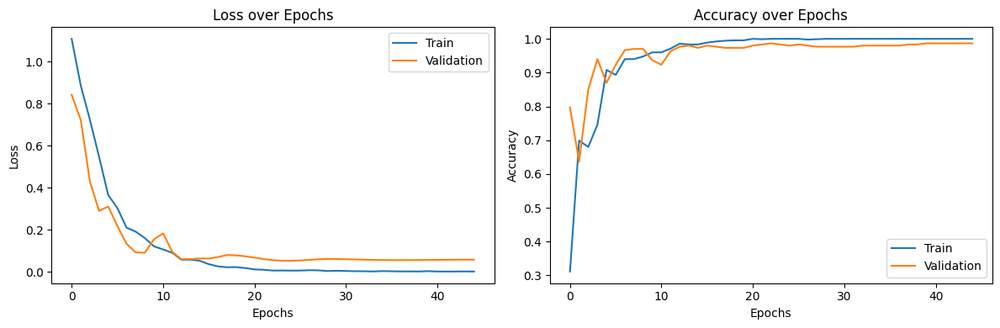

In [11]:
legend = ['Train', 'Validation']

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history['train_loss'], label=legend[0])
plt.plot(history['val_loss'], label=legend[1])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend(loc='upper right')
plt.title('Loss over Epochs')

plt.subplot(1, 2, 2)
plt.plot(history['train_acc'], label=legend[0])
plt.plot(history['val_acc'], label=legend[1])
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')
plt.title('Accuracy over Epochs')

plt.tight_layout()
plt.show()

## 7. Evaluate the model

### 7.1 Classify testdata using model

In [12]:
final_model.eval()
all_preds = []
all_labels = []
all_images = []
all_probs = []
class_labels = ['Late Blight', 'Early Blight', 'Healthy']

selected_indices = best_features == 1

with torch.no_grad():
    for data, labels in test_loader:
        data, labels = data.to(device), labels.to(device)

        features = alexnet.features(data).view(data.size(0), -1)

        selected_features = features[:, selected_indices]

        outputs = final_model(selected_features)
        probabilities = torch.softmax(outputs, dim=1)
        _, predicted = torch.max(outputs, 1)

        all_preds.extend(predicted.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_images.extend(data.cpu())
        all_probs.extend(probabilities.cpu().numpy())

correct_classifications = sum(np.array(all_preds) == np.array(all_labels))
incorrect_classifications = len(all_labels) - correct_classifications

print(f'Correctly classified: {correct_classifications}')
print(f'Incorrectly classified: {incorrect_classifications}')


Correctly classified: 297
Incorrectly classified: 3


### 7.2 Show confusion matrix of results

Explanation of the highlighted cells:
- Red rectangles: These cells represent cases where the illness is mistakenly classified as healthy. These cells have to be zero.
- Yellow rectangle: This cell represents cases where the severity of the illness is underestimated.
- Green rectangles: These are correct classifications.
- Other cells: These represent overestimated illness severity, which is less critical than underestimating.



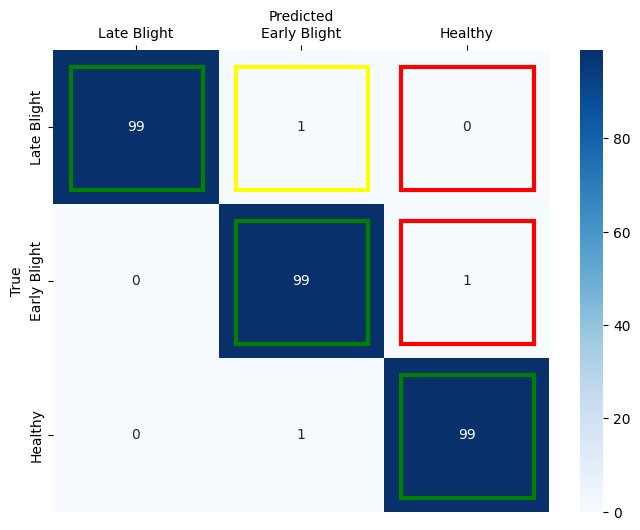

In [13]:
cm = confusion_matrix(all_labels, all_preds)

plt.figure(figsize=(8, 6))
ax = sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()
highlight_cells = [(0, 2), (0, 1), (1, 2), (0, 0), (1, 1), (2, 2)]

for (i, j) in highlight_cells:
    trans = mtransforms.offset_copy(ax.transData, fig=ax.figure, x=+12.5, y=-12.5, units='points')
    if (i, j) == (0, 1):
        color = 'yellow'
    elif (i, j) in [(0, 2), (1, 2)]:
        color = 'red'
    else:
        color = 'green'

    ax.add_patch(Rectangle((j, i), 0.8, 0.8, fill=False, edgecolor=color, lw=3, transform=trans))

plt.xlabel('Predicted')
plt.ylabel('True')
plt.show()


### 7.3 Define helper functions




In [14]:
def imshow(img):
    img = img / 2 + 0.5
    img = np.clip(img, 0, 1)
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')

def plot_probabilities(probs, class_labels, true_label_index, pred_label_index):
    bar_positions = np.arange(len(class_labels))  # X positions for bars
    probs_true = np.zeros_like(probs)
    probs_true[true_label_index] = 1  # Set true label to 1 for green bar

    plt.bar(bar_positions - 0.15, probs, width=0.3, color='blue', label='Predicted')

    plt.bar(bar_positions + 0.15, probs_true, width=0.3, color='green', label='True')

    plt.xticks(bar_positions, class_labels, fontsize=9)

    for i, (x, prob) in enumerate(zip(bar_positions, probs)):
        plt.text(x - 0.15, prob + 0.02, f'{prob:.2f}', ha='center', fontsize=6)

    plt.text(bar_positions[true_label_index] + 0.15, 1.02, '1.00', ha='center', fontsize=6)

    plt.ylim(0, 1.1)
    plt.ylabel('Probability')
    plt.tight_layout()

### 7.4 Show 9 correctly classified examples

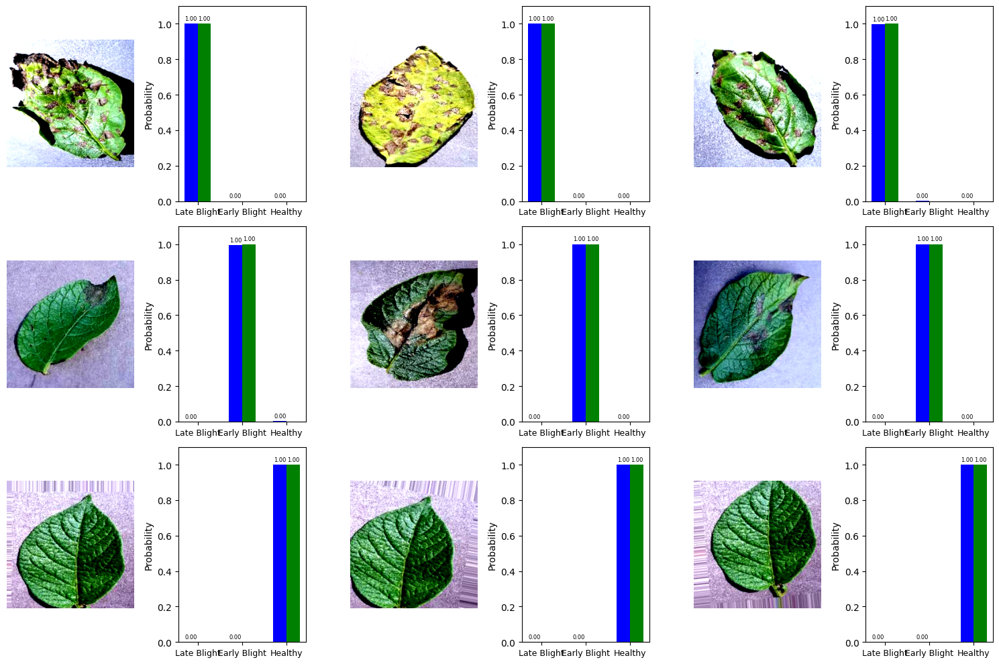

In [15]:
plt.figure(figsize=(15, 10))
num_samples_per_class = 3
samples_collected = {class_name: 0 for class_name in class_labels}

for i, (img, true_label, pred_label, prob) in enumerate(zip(all_images, all_labels, all_preds, all_probs)):
    true_class_name = class_labels[true_label]
    pred_class_name = class_labels[pred_label]

    if true_label == pred_label and samples_collected[true_class_name] < num_samples_per_class:
        samples_collected[true_class_name] += 1
        plt.subplot(len(class_labels), num_samples_per_class * 2, samples_collected[true_class_name] * 2 - 1 + num_samples_per_class * 2 * true_label)
        imshow(img)
        plt.subplot(len(class_labels), num_samples_per_class * 2, samples_collected[true_class_name] * 2 + num_samples_per_class * 2 * true_label)
        plot_probabilities(prob, class_labels, true_label, pred_label)

plt.tight_layout()
plt.show()

### 6.4 Show all misclassified images

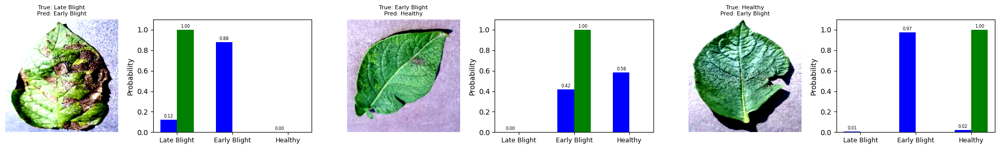

In [16]:
misclassified_images = [(img, true_label, pred_label, prob) for img, true_label, pred_label, prob in zip(all_images, all_labels, all_preds, all_probs) if true_label != pred_label]
num_misclassified = len(misclassified_images)

max_misclassified = 99
num_rows = min(33, (num_misclassified + 2) // 3)

plt.figure(figsize=(20, 3 * num_rows))

for i, (img, true_label, pred_label, prob) in enumerate(misclassified_images[:max_misclassified]):
    plt.subplot(num_rows, 6, i * 2 + 1)
    imshow(img)
    plt.title(f'True: {class_labels[true_label]}\nPred: {class_labels[pred_label]}', fontsize=8)
    plt.subplot(num_rows, 6, i * 2 + 2)
    plot_probabilities(prob, class_labels, true_label, pred_label)

plt.tight_layout()
plt.show()


Example 1:


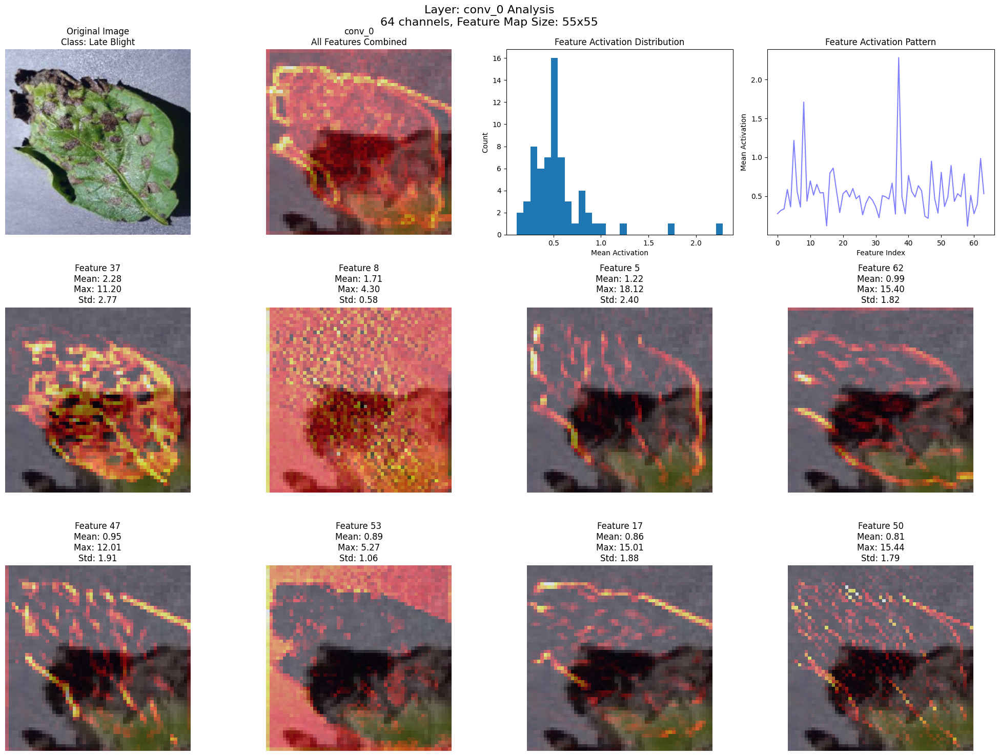


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5522
Max activation: 18.4715
Std deviation: 1.1864
--------------------------------------------------


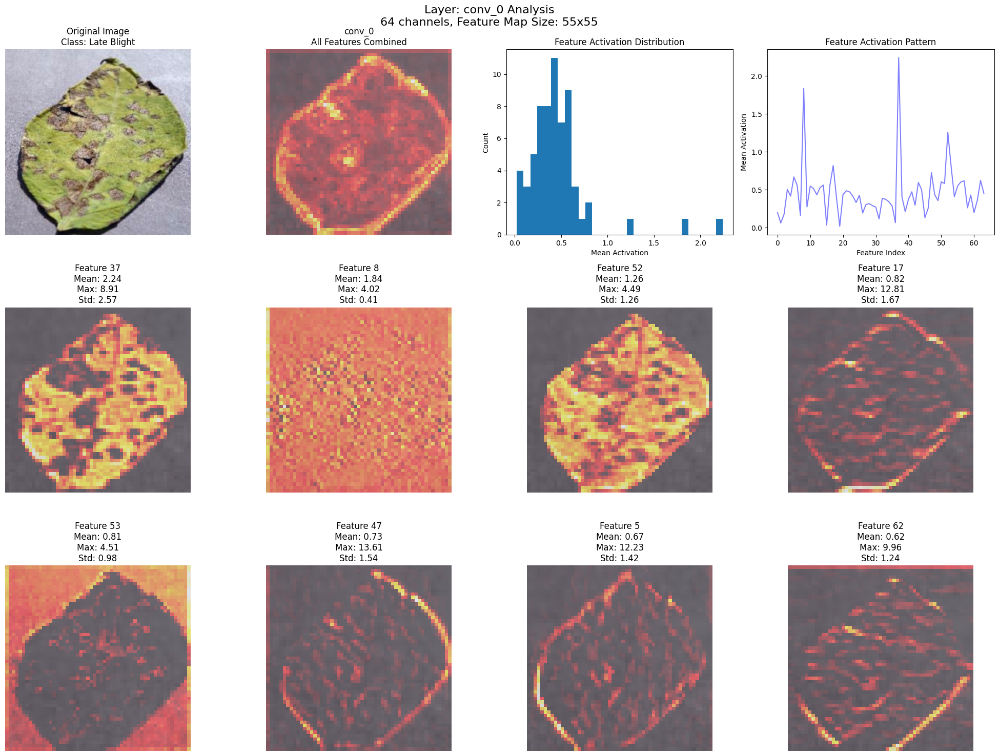


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4628
Max activation: 18.6794
Std deviation: 1.0363
--------------------------------------------------

Example 2:


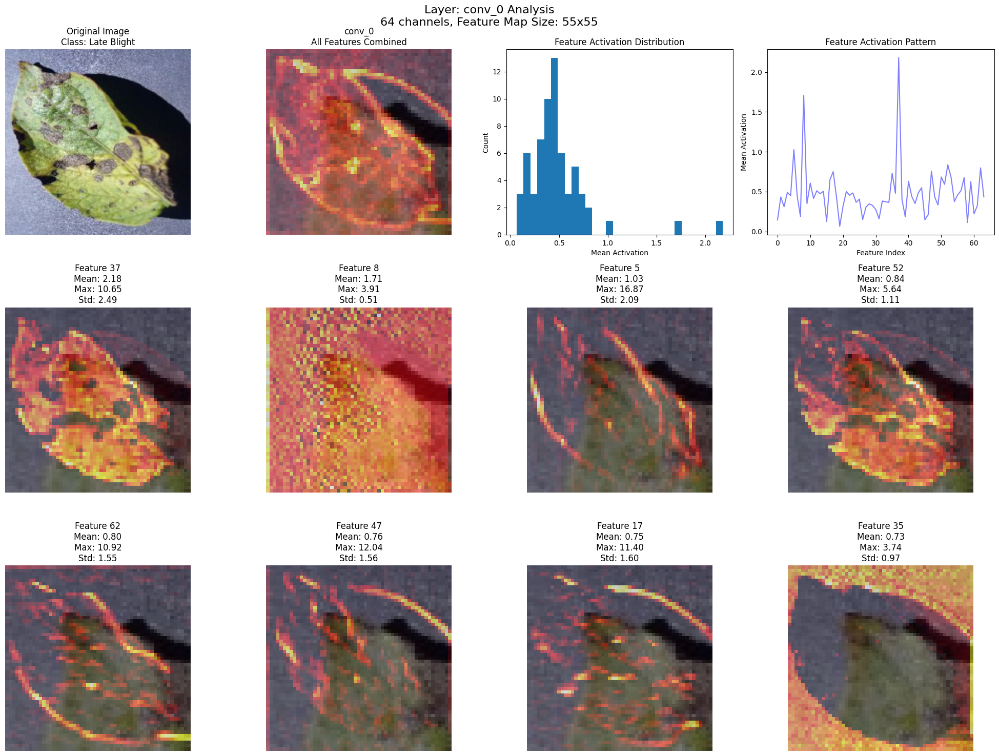


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4828
Max activation: 16.8686
Std deviation: 1.0527
--------------------------------------------------


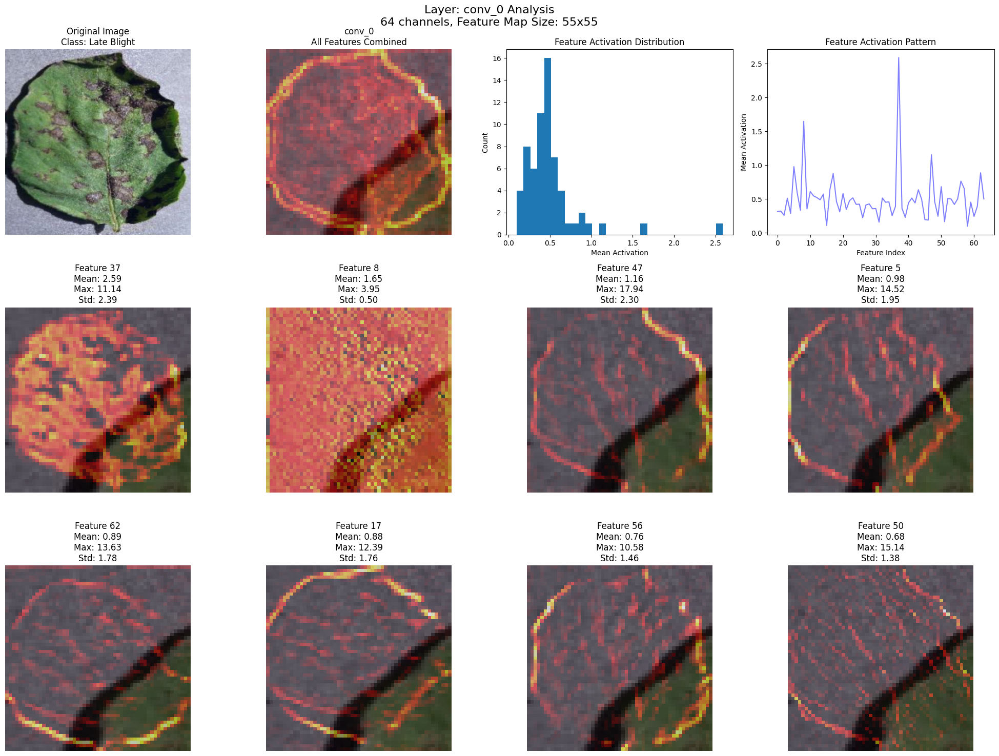


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5039
Max activation: 17.9429
Std deviation: 1.0883
--------------------------------------------------

Example 3:


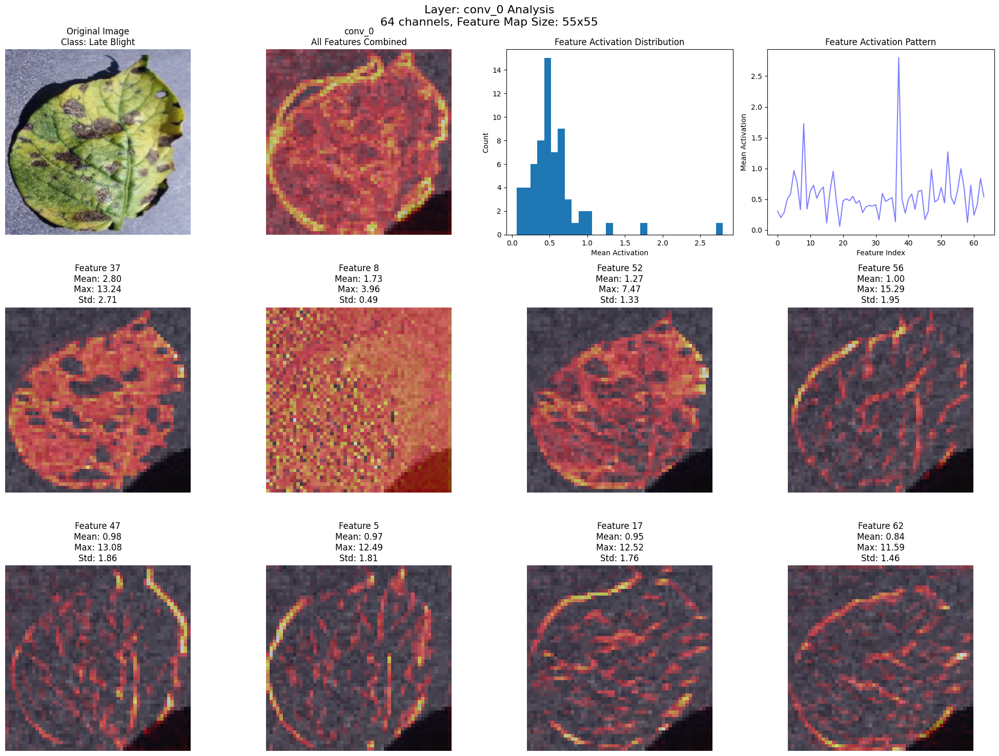


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5601
Max activation: 17.4808
Std deviation: 1.1655
--------------------------------------------------


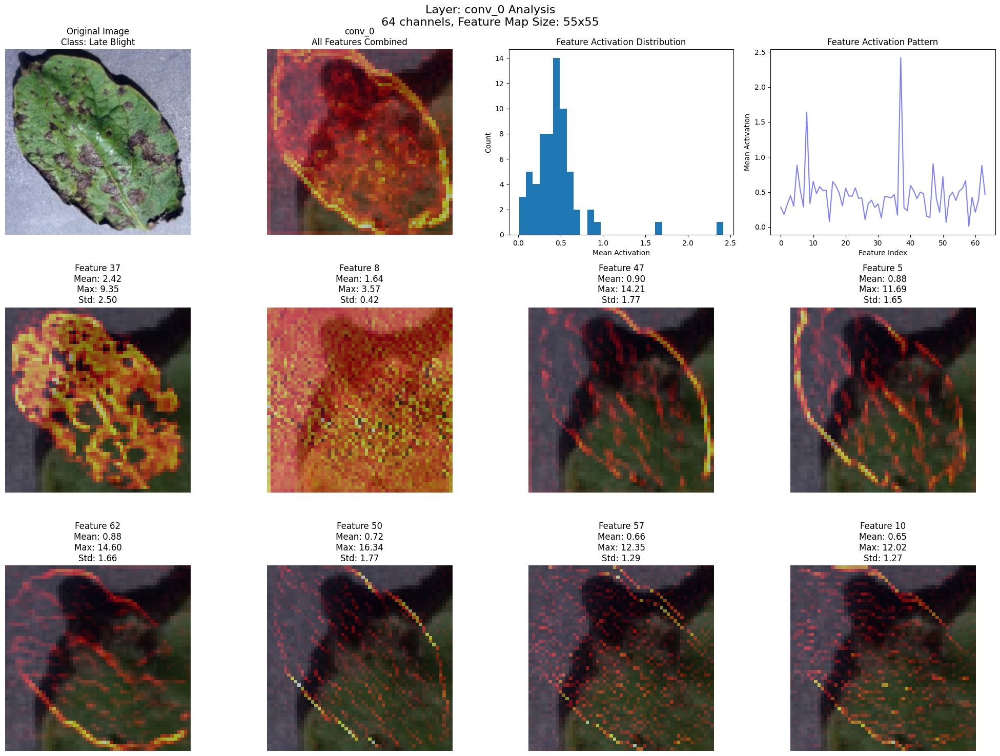


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4653
Max activation: 16.3443
Std deviation: 0.9941
--------------------------------------------------

Example 4:


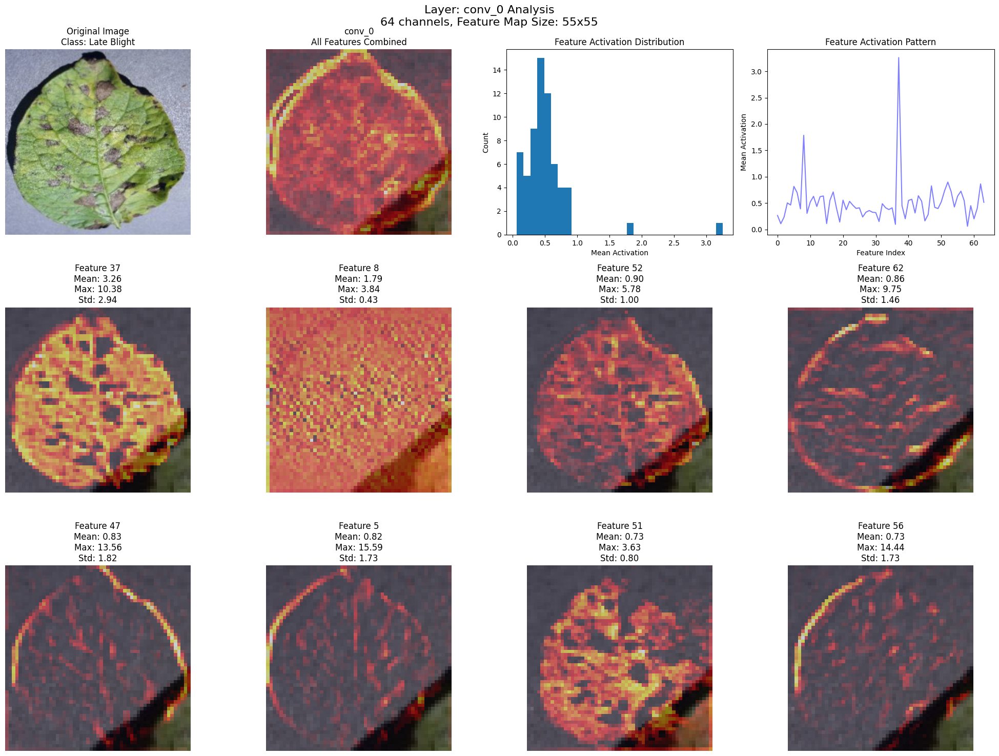


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5143
Max activation: 18.4626
Std deviation: 1.1211
--------------------------------------------------


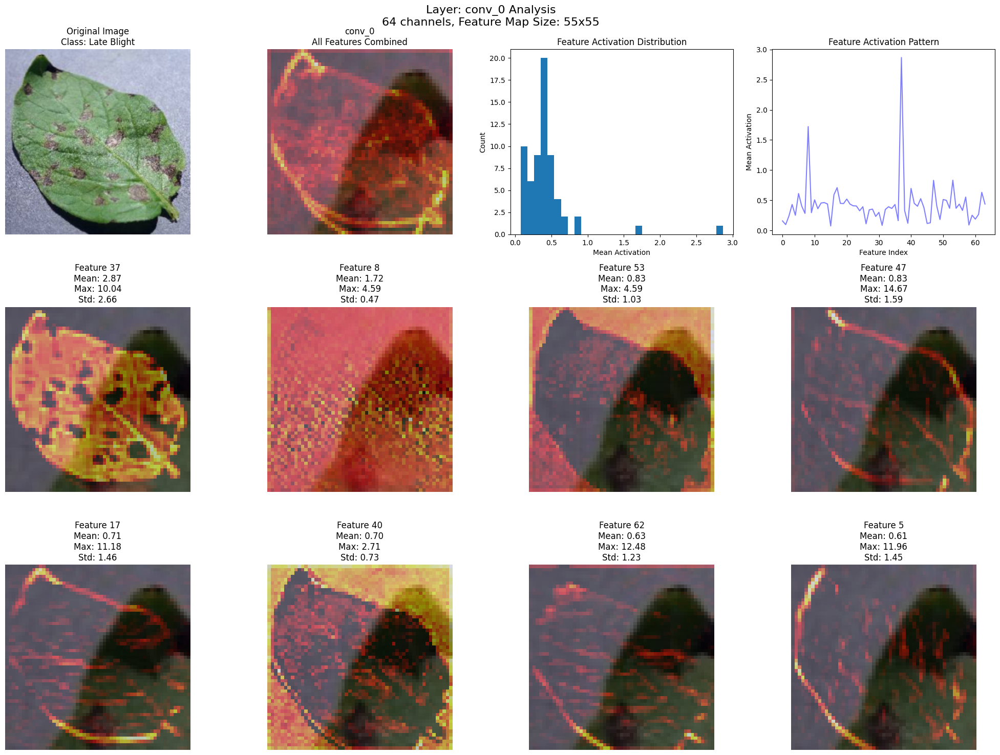


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4355
Max activation: 16.4030
Std deviation: 0.9639
--------------------------------------------------

Example 5:


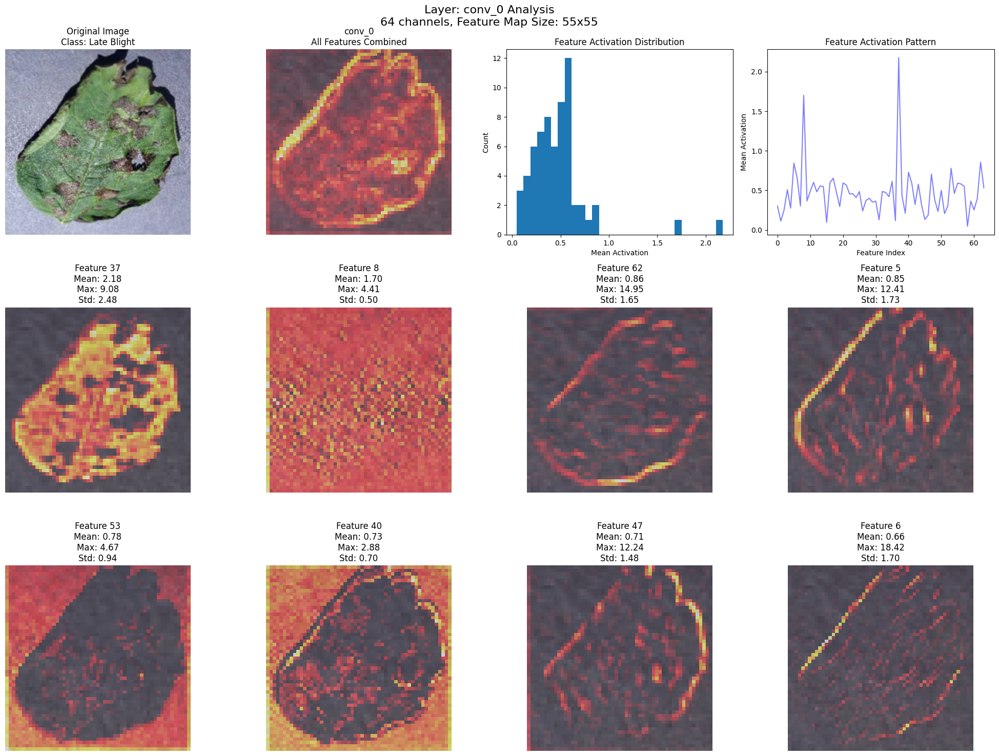


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4759
Max activation: 18.4187
Std deviation: 1.0360
--------------------------------------------------


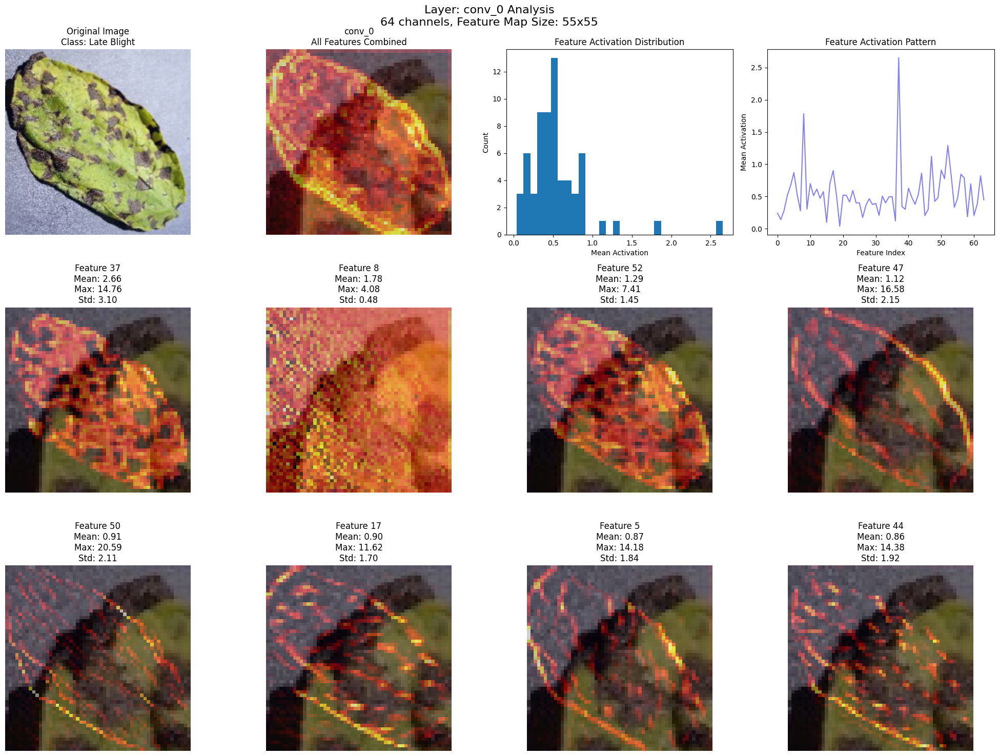


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5511
Max activation: 20.5907
Std deviation: 1.2100
--------------------------------------------------

Example 6:


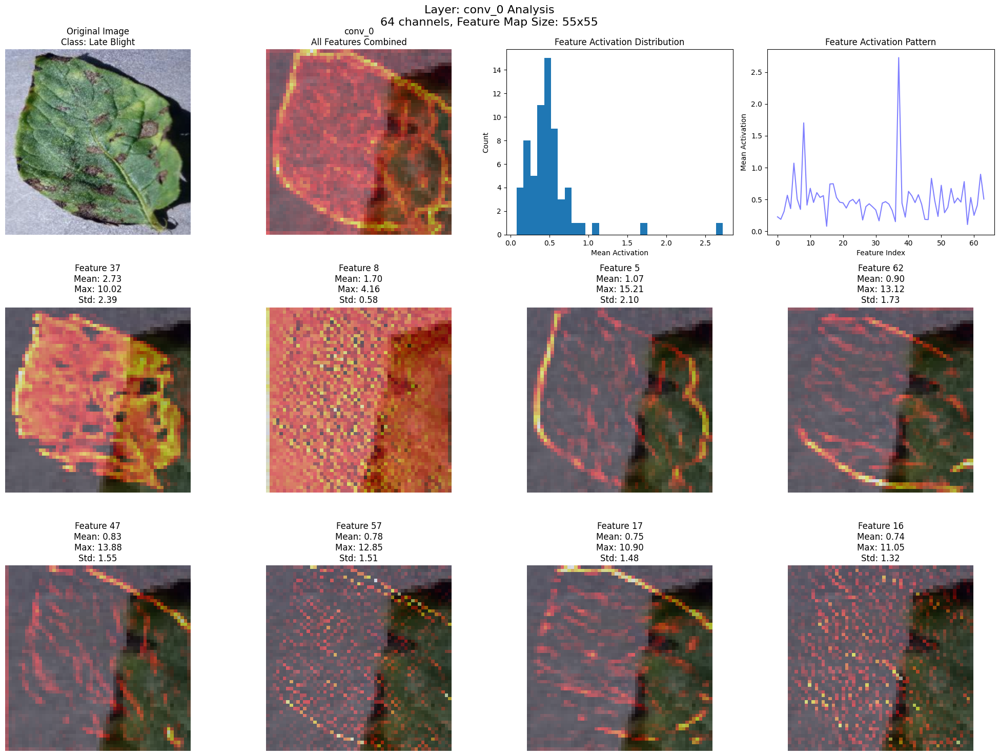


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.5063
Max activation: 18.1551
Std deviation: 1.0662
--------------------------------------------------


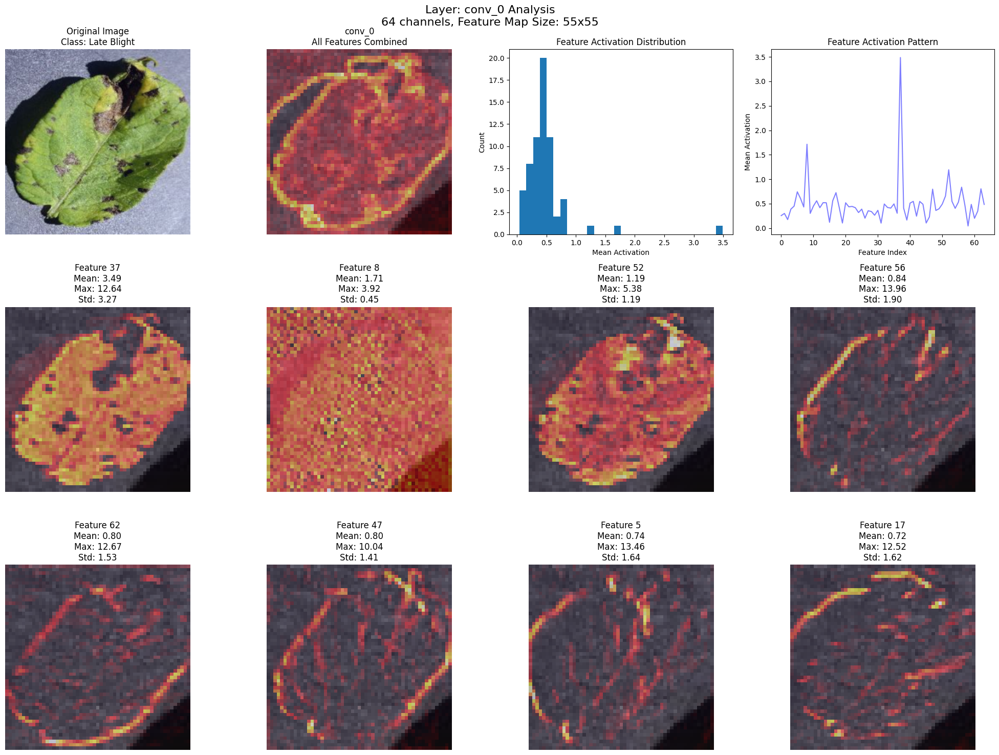


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4968
Max activation: 16.1130
Std deviation: 1.1060
--------------------------------------------------

Example 7:


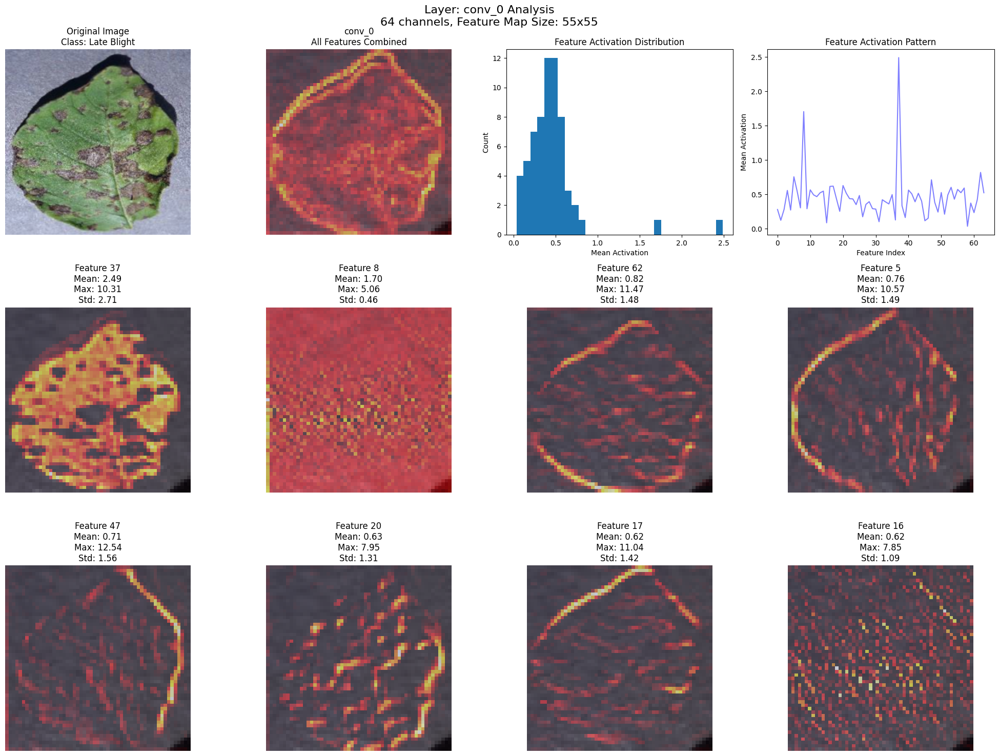


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4585
Max activation: 18.3293
Std deviation: 0.9956
--------------------------------------------------


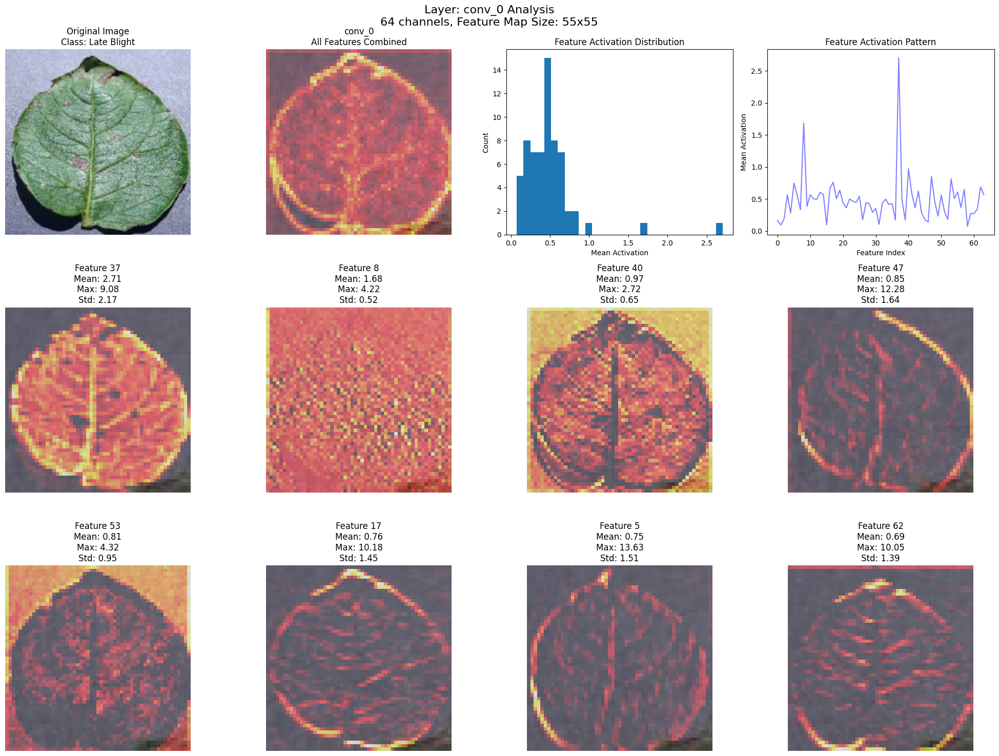


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4857
Max activation: 16.8778
Std deviation: 1.0035
--------------------------------------------------

Example 8:


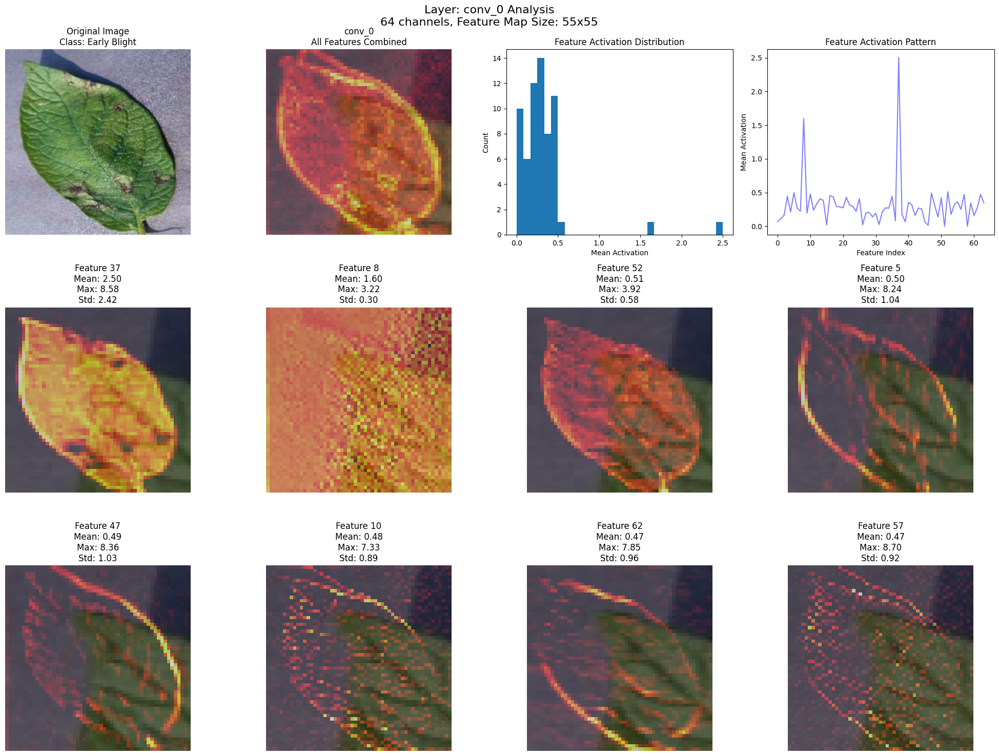


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3183
Max activation: 10.5318
Std deviation: 0.7367
--------------------------------------------------


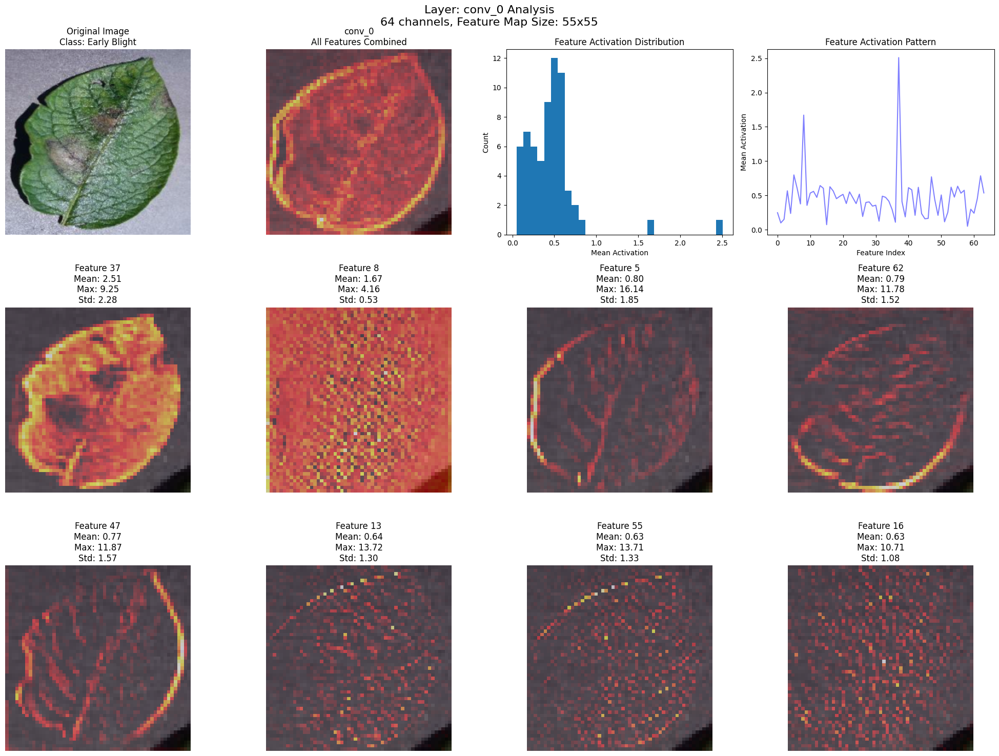


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4645
Max activation: 16.1387
Std deviation: 1.0139
--------------------------------------------------

Example 9:


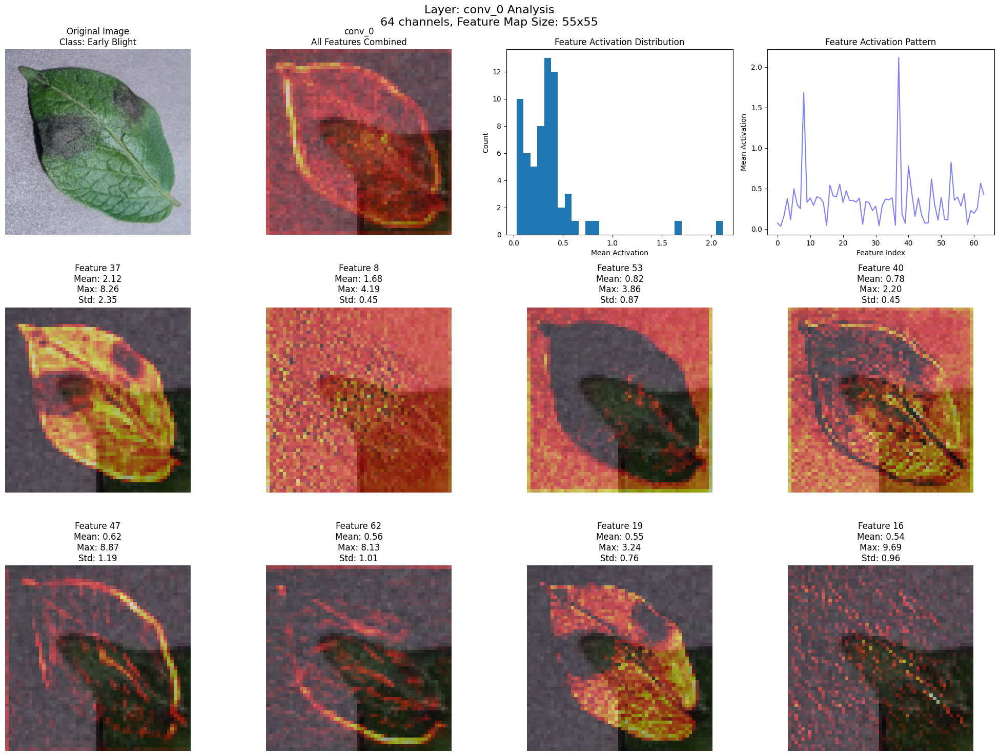


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3523
Max activation: 14.4207
Std deviation: 0.7809
--------------------------------------------------


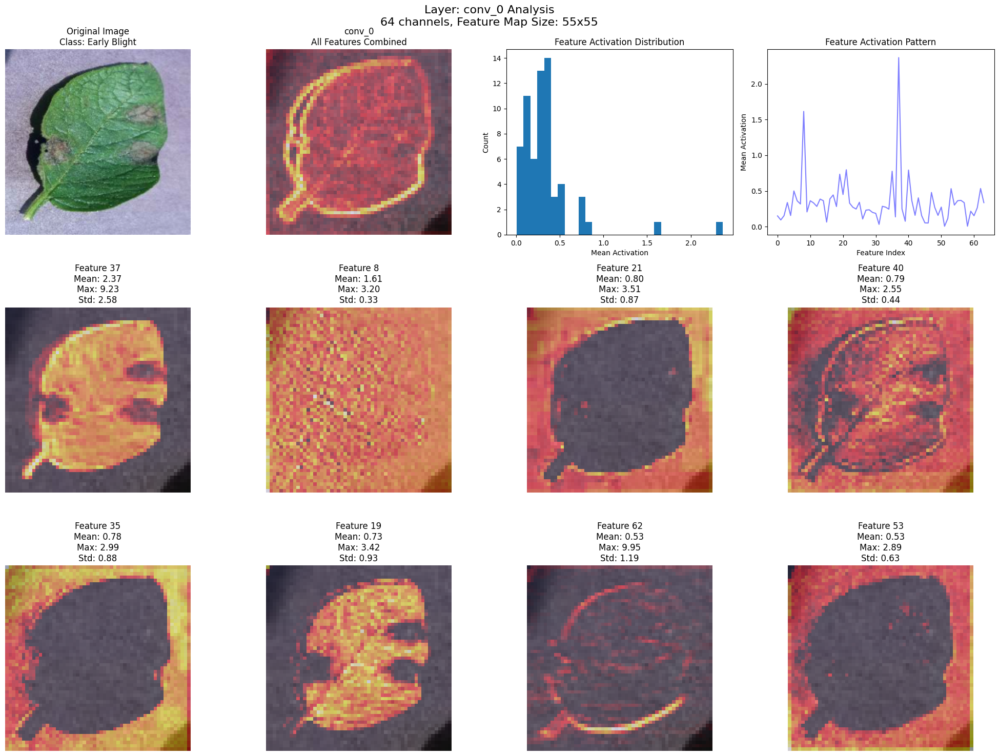


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3443
Max activation: 11.4658
Std deviation: 0.8085
--------------------------------------------------

Example 10:


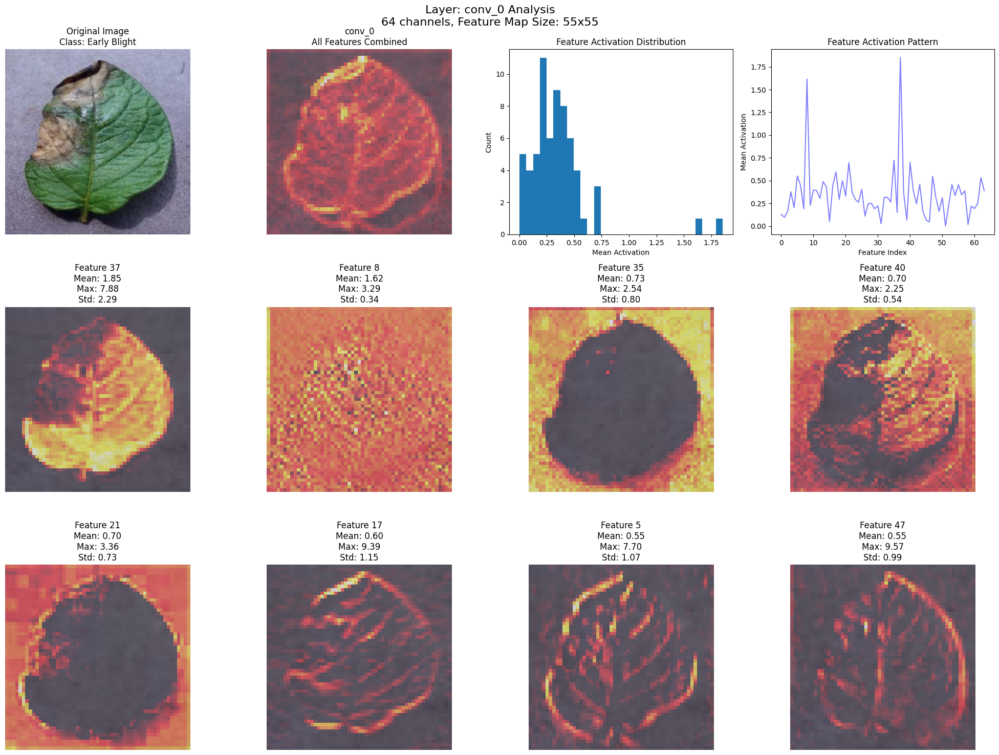


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3536
Max activation: 13.0332
Std deviation: 0.7673
--------------------------------------------------


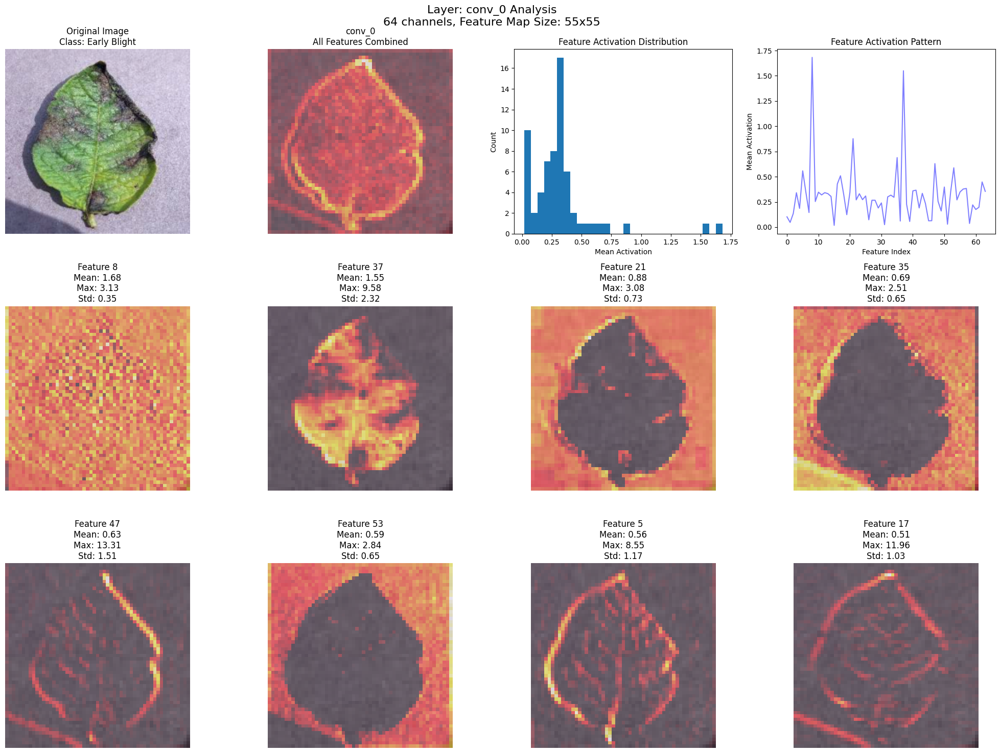


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3228
Max activation: 13.3085
Std deviation: 0.7356
--------------------------------------------------

Example 11:


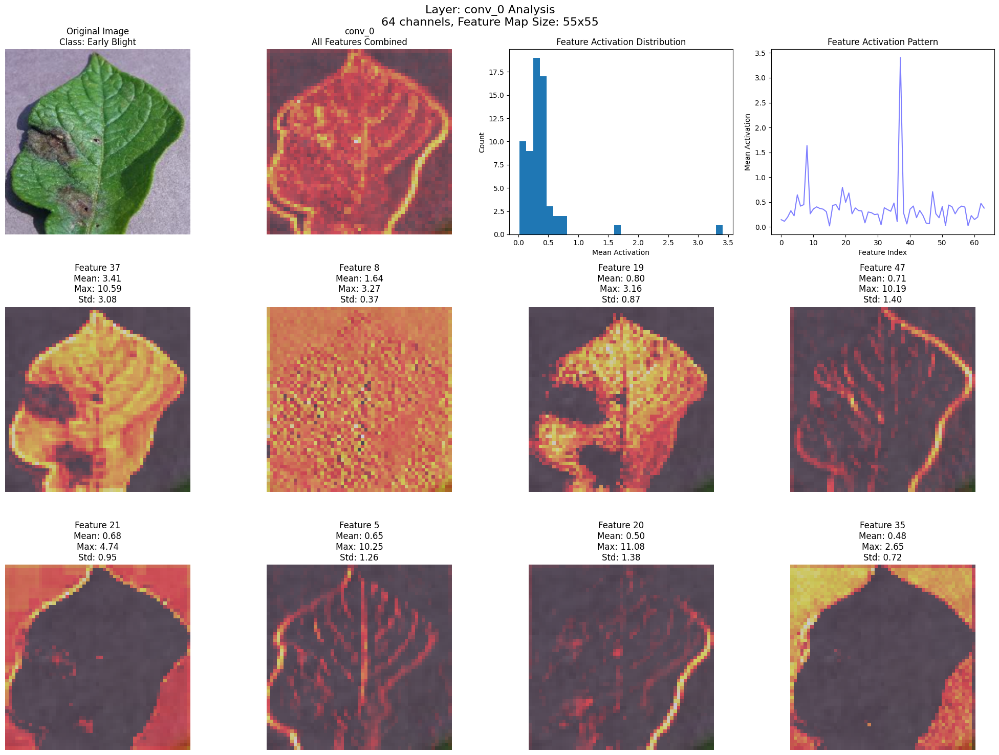


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3809
Max activation: 11.0827
Std deviation: 0.8879
--------------------------------------------------


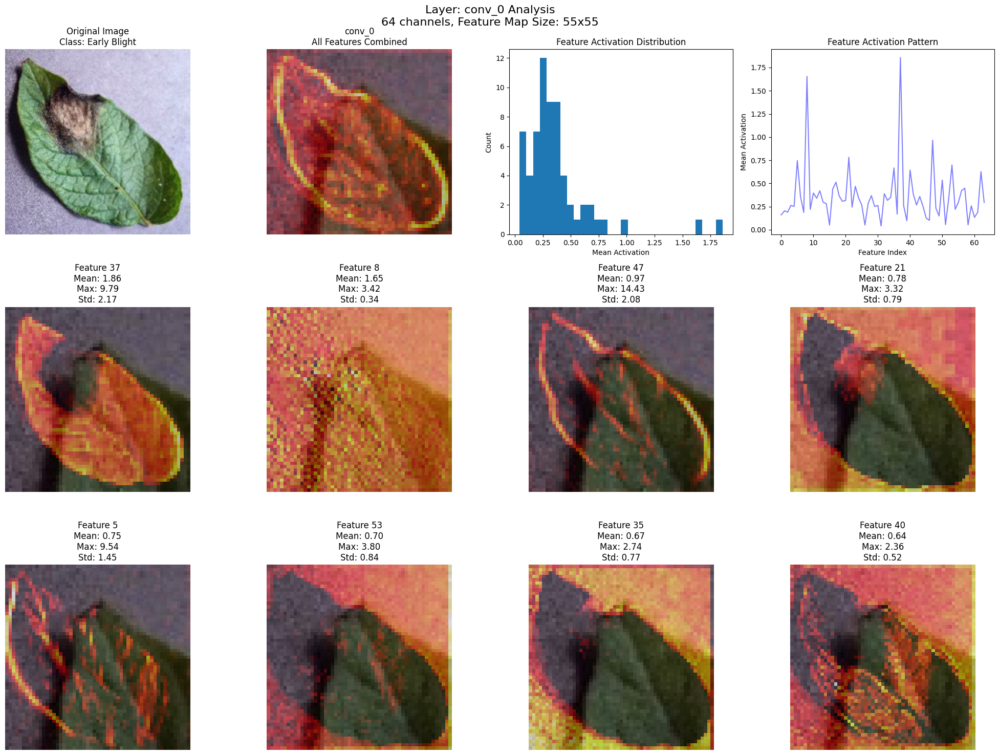


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3673
Max activation: 14.4314
Std deviation: 0.8290
--------------------------------------------------

Example 12:


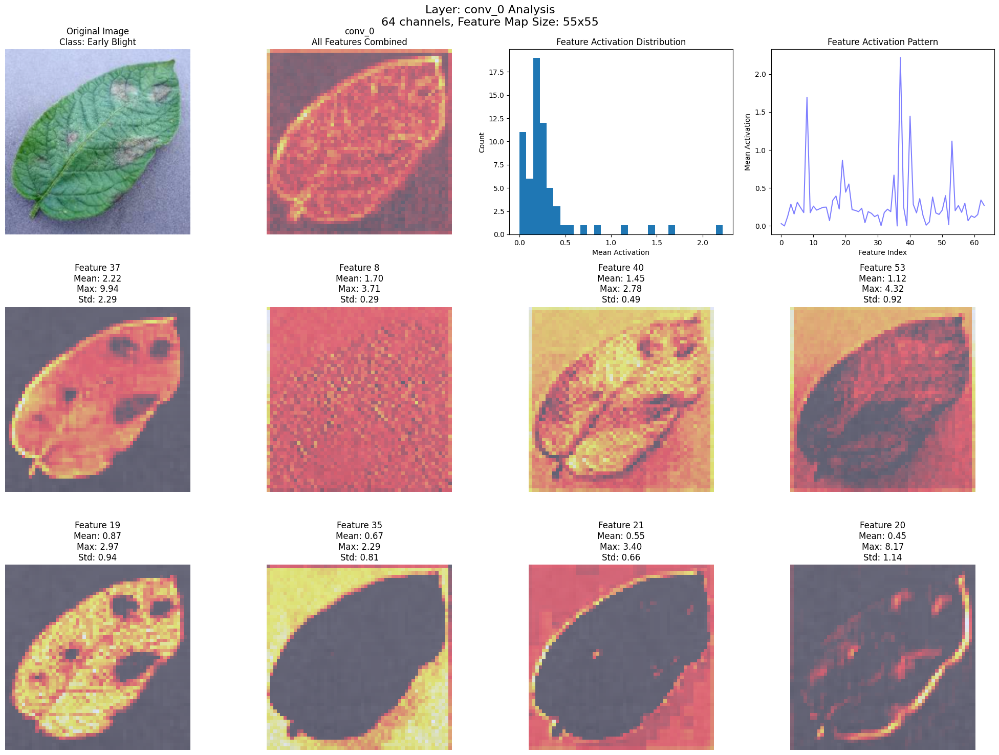


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3041
Max activation: 9.9352
Std deviation: 0.6796
--------------------------------------------------


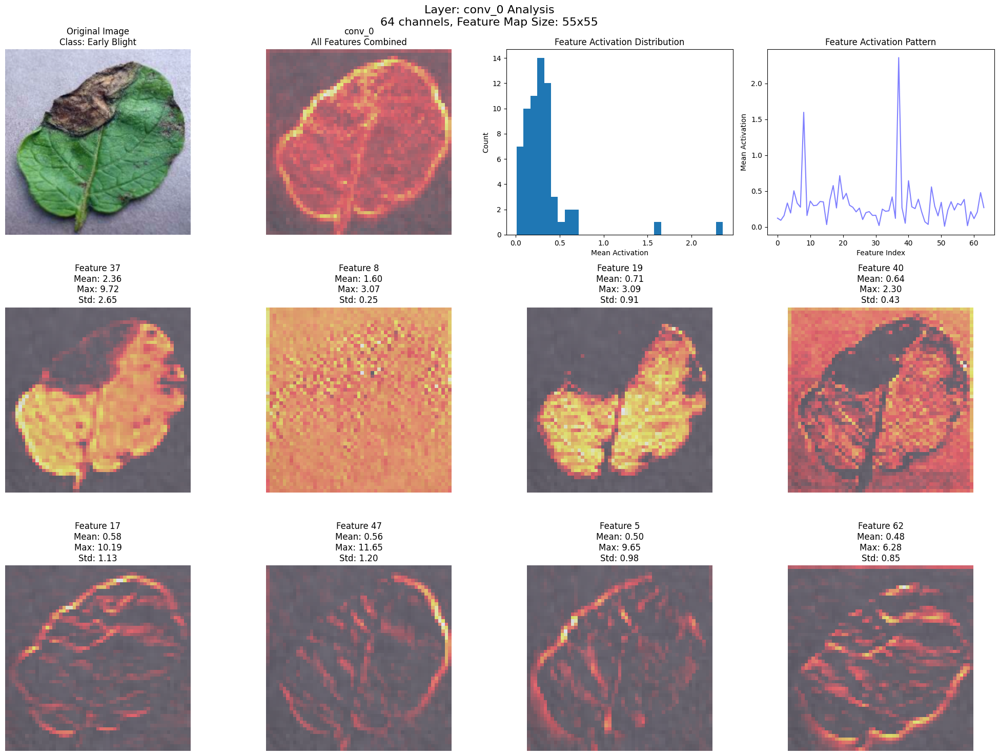


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3185
Max activation: 11.8412
Std deviation: 0.7601
--------------------------------------------------

Example 13:


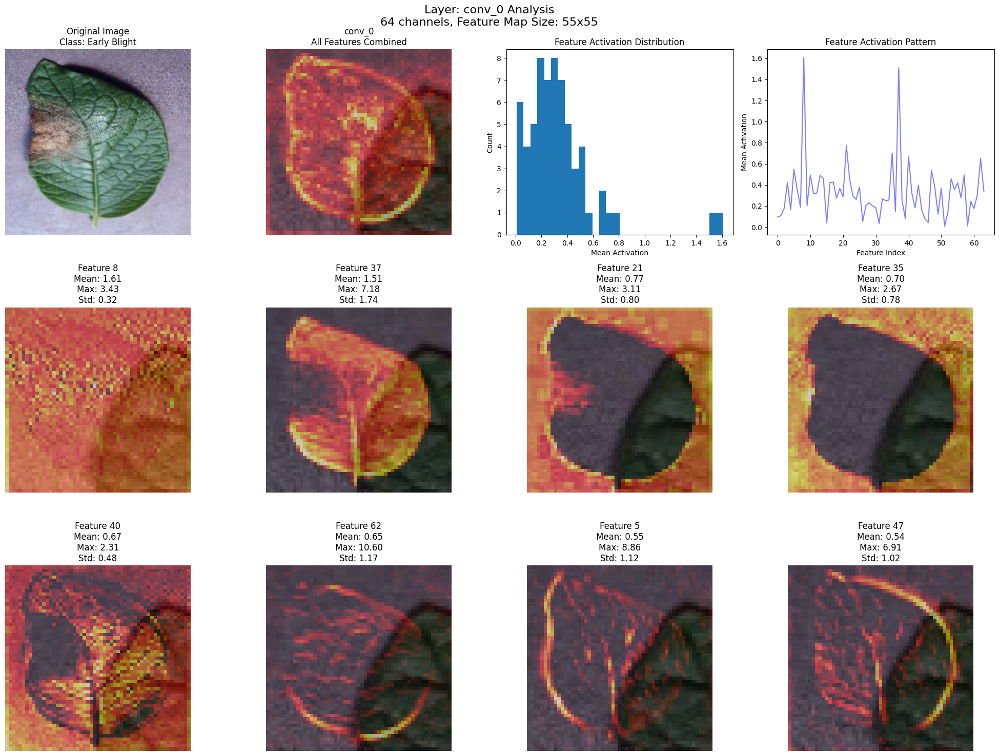


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3351
Max activation: 10.5950
Std deviation: 0.7275
--------------------------------------------------


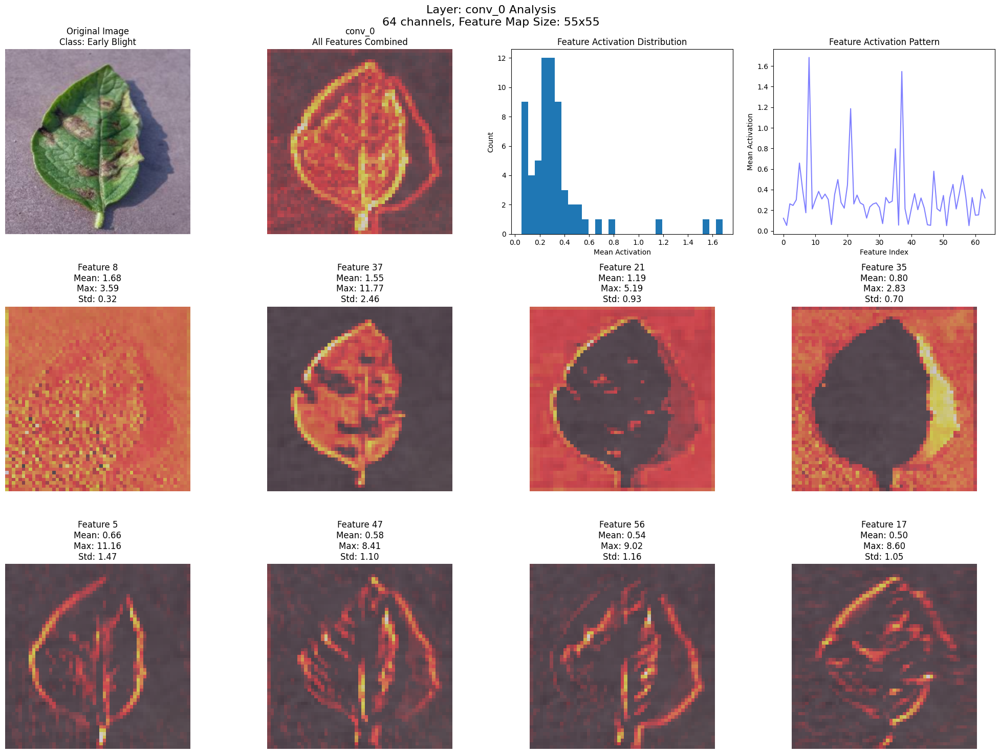


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3299
Max activation: 11.7728
Std deviation: 0.7792
--------------------------------------------------

Example 14:


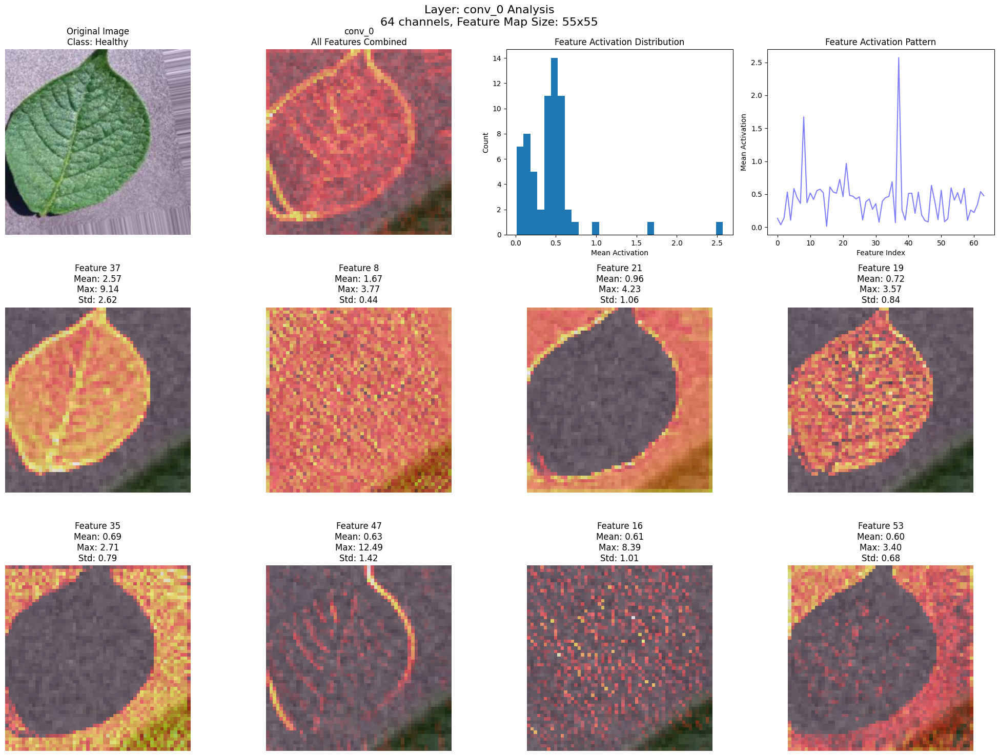


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4331
Max activation: 12.5565
Std deviation: 0.9102
--------------------------------------------------


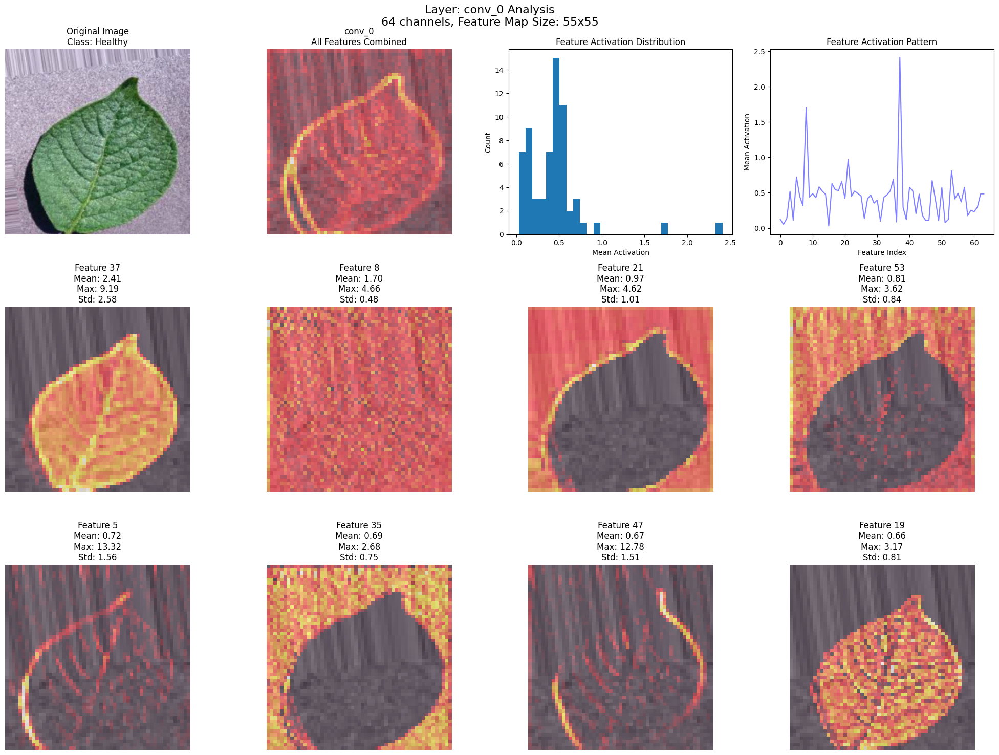


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4428
Max activation: 13.4624
Std deviation: 0.9250
--------------------------------------------------

Example 15:


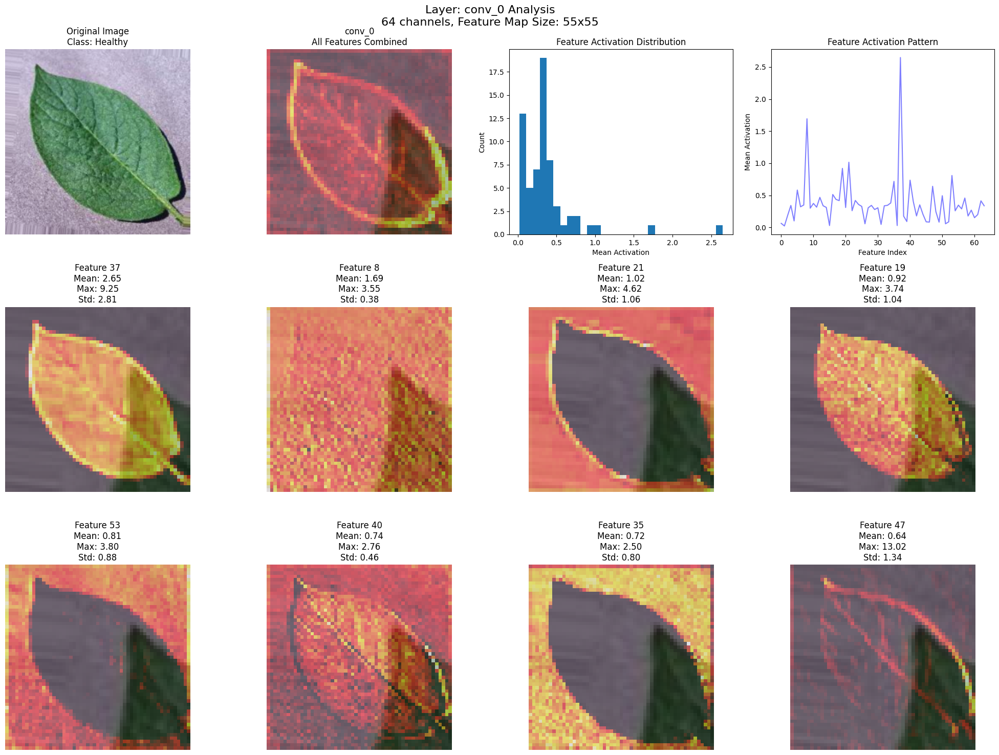


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3786
Max activation: 16.9487
Std deviation: 0.8625
--------------------------------------------------


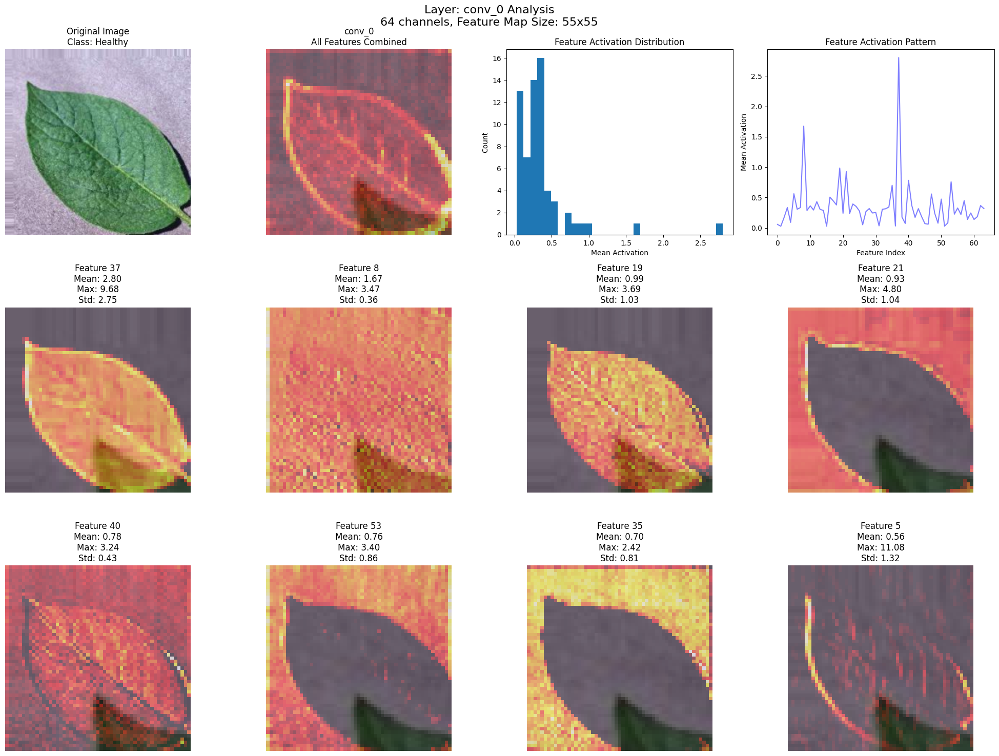


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3598
Max activation: 18.2203
Std deviation: 0.8234
--------------------------------------------------

Example 16:


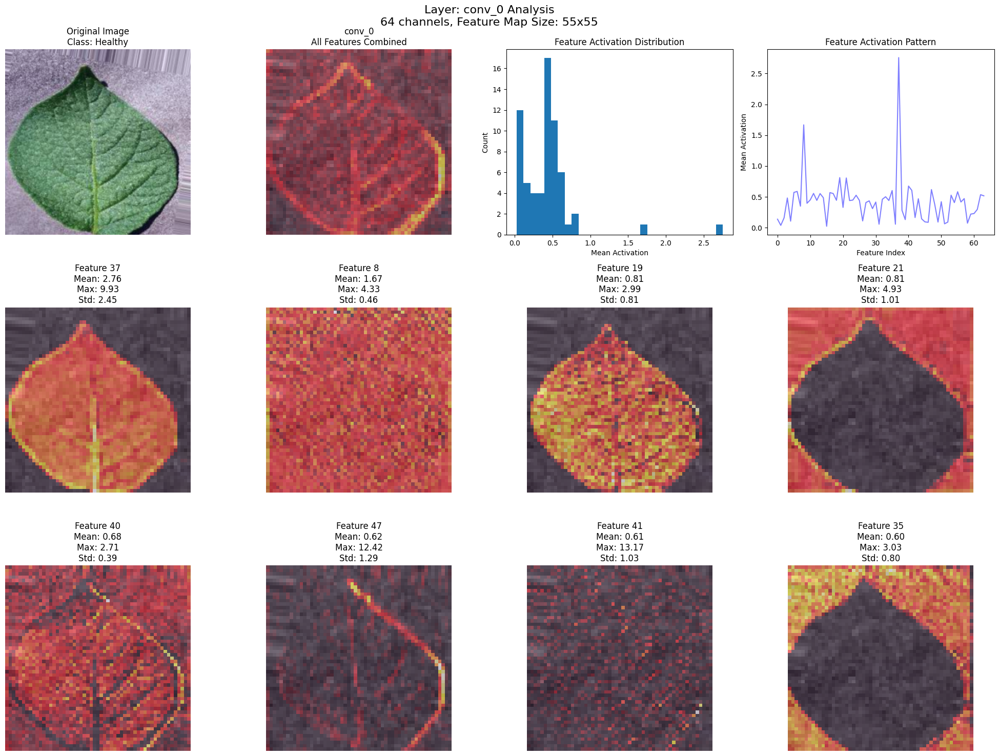


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4311
Max activation: 17.6236
Std deviation: 0.8957
--------------------------------------------------


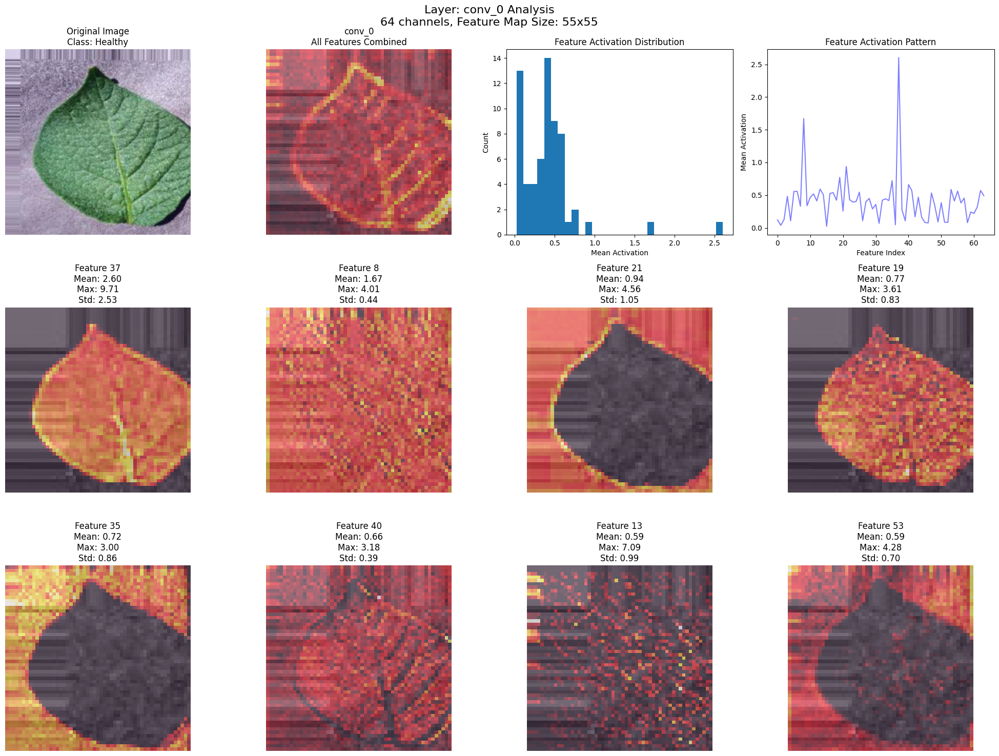


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4193
Max activation: 12.1165
Std deviation: 0.8766
--------------------------------------------------

Example 17:


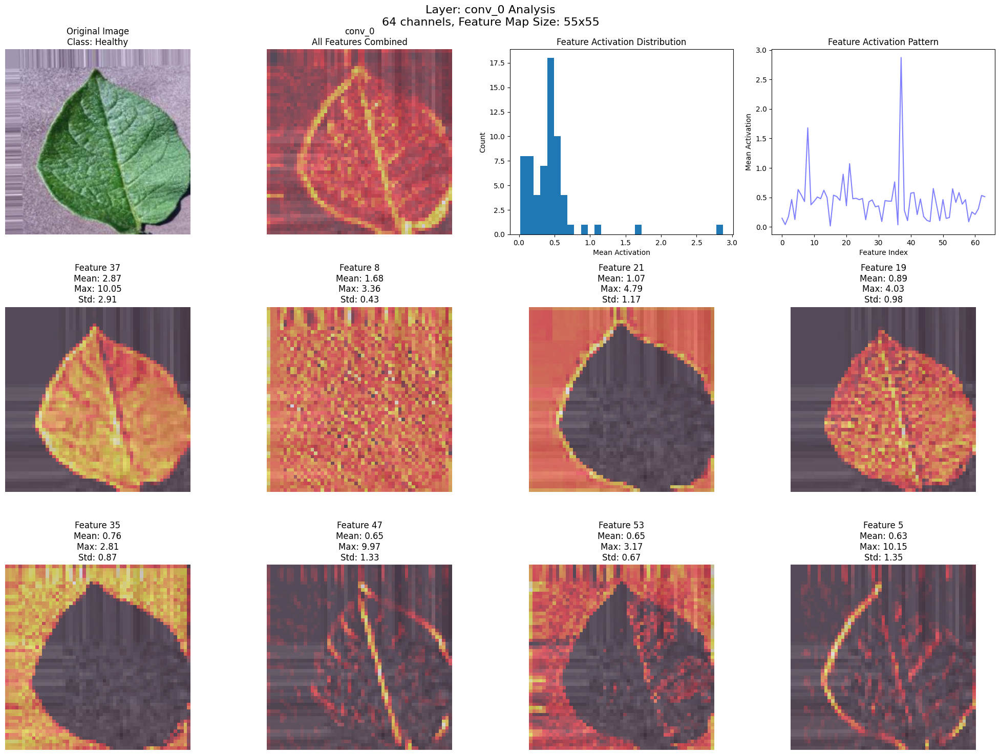


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4466
Max activation: 11.8428
Std deviation: 0.9476
--------------------------------------------------


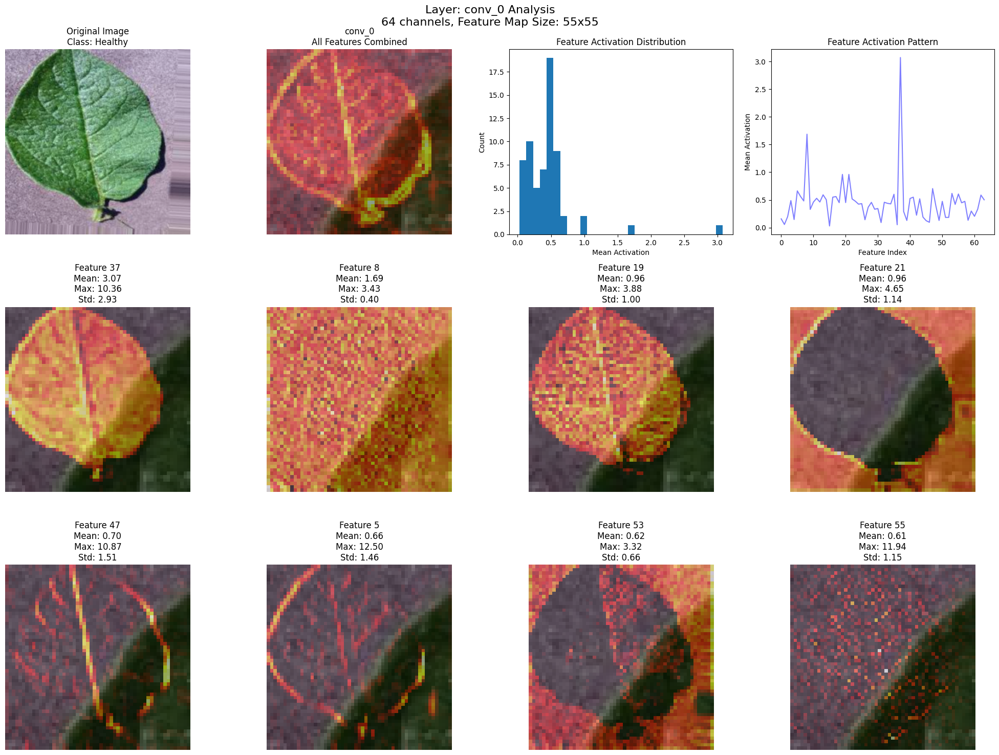


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4567
Max activation: 14.2273
Std deviation: 0.9807
--------------------------------------------------

Example 18:


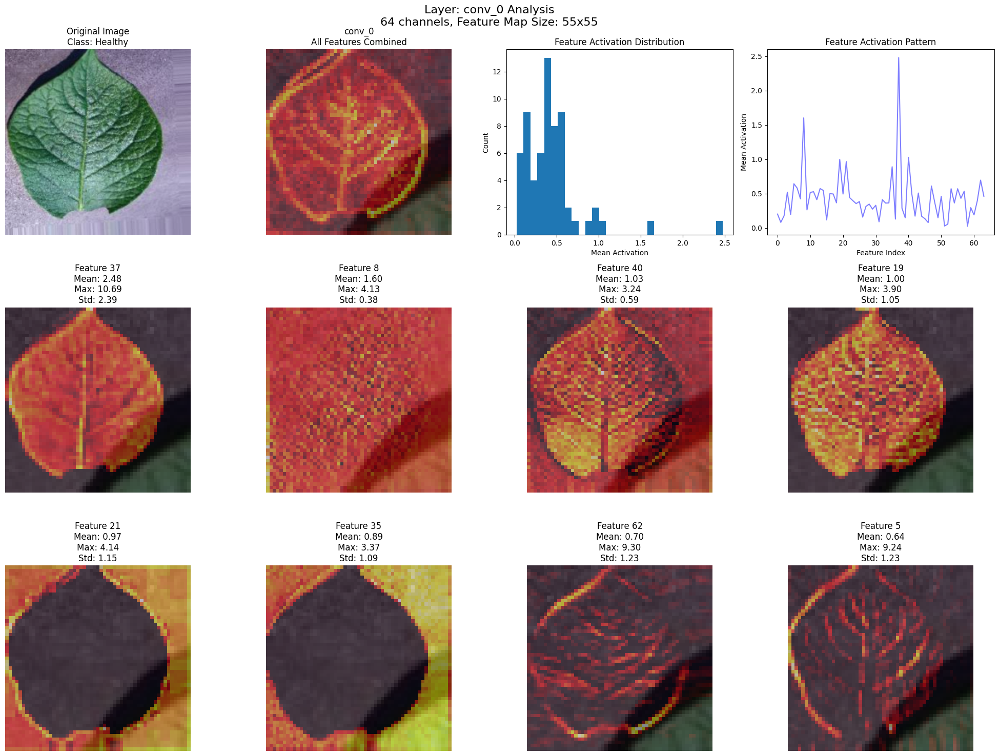


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4412
Max activation: 11.8735
Std deviation: 0.9405
--------------------------------------------------


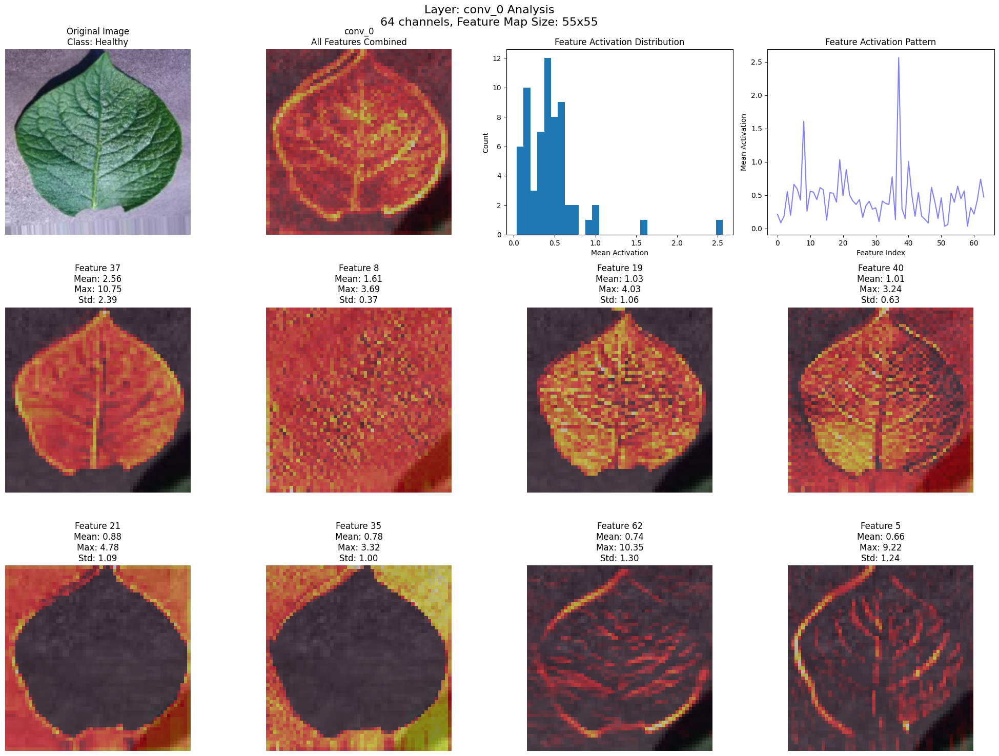


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.4545
Max activation: 13.3910
Std deviation: 0.9548
--------------------------------------------------

Example 19:


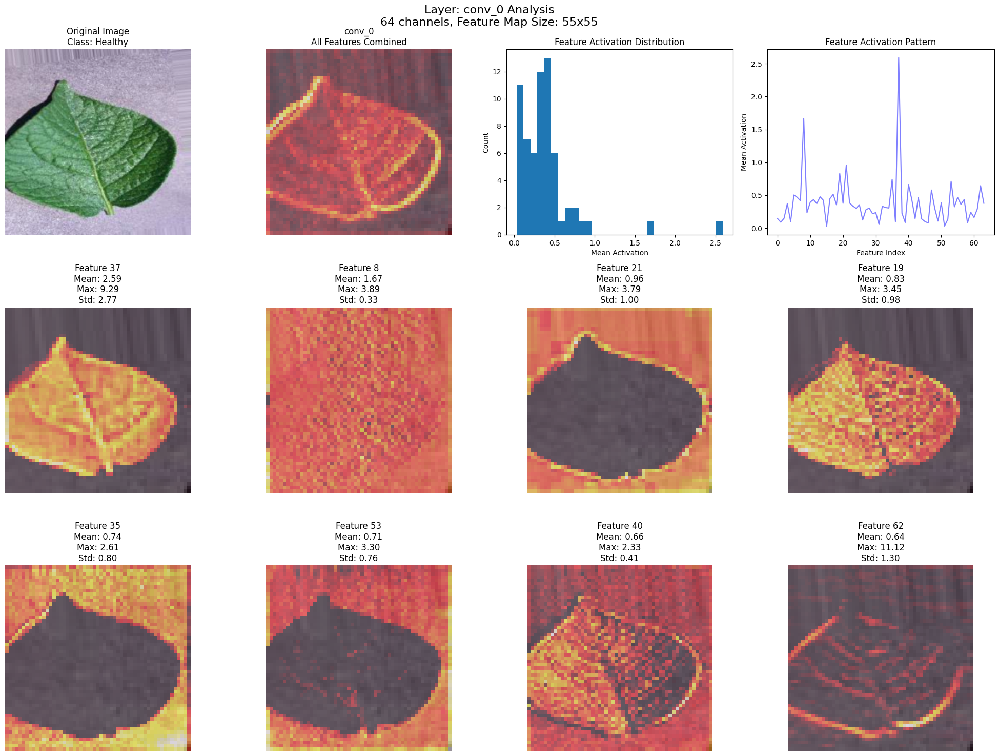


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3862
Max activation: 12.5026
Std deviation: 0.8807
--------------------------------------------------


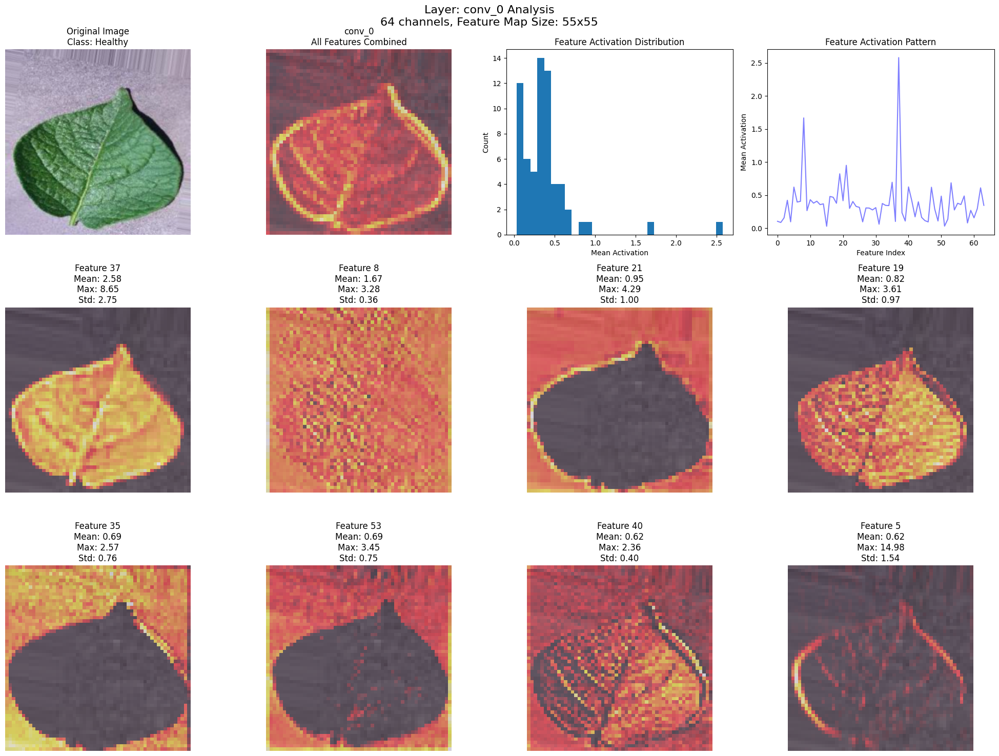


Layer conv_0 Statistics:
Number of channels: 64
Feature map size: 55x55
Mean activation: 0.3864
Max activation: 17.5381
Std deviation: 0.8931
--------------------------------------------------


In [33]:
def analyze_detailed_features(model, image, label, best_features):
    # Store activations from all convolutional layers
    activations = {}
    def get_activation(name):
        def hook(module, input, output):
            activations[name] = output
        return hook

    # Register hooks for all convolutional layers
    hooks = []
    for name, module in model.features.named_children():
        if isinstance(module, nn.Conv2d):
            hooks.append(module.register_forward_hook(get_activation(f'conv_{name}')))

    # Forward pass
    with torch.no_grad():
        _ = model(image.unsqueeze(0).to(device))

    # Remove hooks
    for hook in hooks:
        hook.remove()

    # Original image processing
    img_np = image.cpu().numpy().transpose(1, 2, 0)
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min())

    # For each convolutional layer
    for layer_name, activation in activations.items():
        feature_maps = activation[0].cpu()  # Shape: [channels, height, width]
        n_channels = feature_maps.shape[0]

        # Create figure for this layer
        plt.figure(figsize=(20, 15))

        # 1. Original Image
        plt.subplot(3, 4, 1)
        plt.imshow(img_np)
        plt.title(f'Original Image\nClass: {class_labels[label]}')
        plt.axis('off')

        # 2. All Features Combined
        all_features = torch.mean(feature_maps, dim=0).numpy()
        all_features = (all_features - all_features.min()) / (all_features.max() - all_features.min())

        plt.subplot(3, 4, 2)
        plt.imshow(img_np)
        plt.imshow(all_features, alpha=0.5, cmap='hot')
        plt.title(f'{layer_name}\nAll Features Combined')
        plt.axis('off')

        # 3. Feature Activation Distribution
        plt.subplot(3, 4, 3)
        mean_activations = torch.mean(feature_maps, dim=(1,2)).numpy()
        plt.hist(mean_activations, bins=30)
        plt.title('Feature Activation Distribution')
        plt.xlabel('Mean Activation')
        plt.ylabel('Count')

        # 4. Feature Activation Strength
        plt.subplot(3, 4, 4)
        plt.plot(mean_activations, 'b-', alpha=0.5, label='Activation Strength')
        plt.title('Feature Activation Pattern')
        plt.xlabel('Feature Index')
        plt.ylabel('Mean Activation')

        # 5-12. Top 8 Individual Feature Maps
        n_top = 8
        top_indices = torch.argsort(torch.mean(feature_maps, dim=(1,2)), descending=True)[:n_top]

        for i, idx in enumerate(top_indices):
            plt.subplot(3, 4, 5+i)
            feature = feature_maps[idx].numpy()
            feature = (feature - feature.min()) / (feature.max() - feature.min())

            # Create a composite image
            plt.imshow(img_np)
            plt.imshow(feature, alpha=0.5, cmap='hot')

            # Calculate statistics for this feature
            mean_act = torch.mean(feature_maps[idx]).item()
            max_act = torch.max(feature_maps[idx]).item()
            std_act = torch.std(feature_maps[idx]).item()

            plt.title(f'Feature {idx}\nMean: {mean_act:.2f}\nMax: {max_act:.2f}\nStd: {std_act:.2f}')
            plt.axis('off')

        plt.suptitle(f'Layer: {layer_name} Analysis\n{n_channels} channels, Feature Map Size: {feature_maps.shape[1]}x{feature_maps.shape[2]}',
                    fontsize=16)
        plt.tight_layout()
        plt.show()

        # Print layer statistics
        print(f"\nLayer {layer_name} Statistics:")
        print(f"Number of channels: {n_channels}")
        print(f"Feature map size: {feature_maps.shape[1]}x{feature_maps.shape[2]}")
        print(f"Mean activation: {torch.mean(feature_maps).item():.4f}")
        print(f"Max activation: {torch.max(feature_maps).item():.4f}")
        print(f"Std deviation: {torch.std(feature_maps).item():.4f}")
        print("-" * 50)
        break

loader_iter = iter(test_loader)

# Analyze a few examples
for i in range(19):  # Show 2 examples
    print(f"\nExample {i+1}:")
    images, labels = next(loader_iter)
    for j in range(2):
      image = images[j].to(device)
      label = labels[j].item()
      analyze_detailed_features(alexnet, image, label, best_features)